Refresher: Modern Text & Image AI Model Architectures

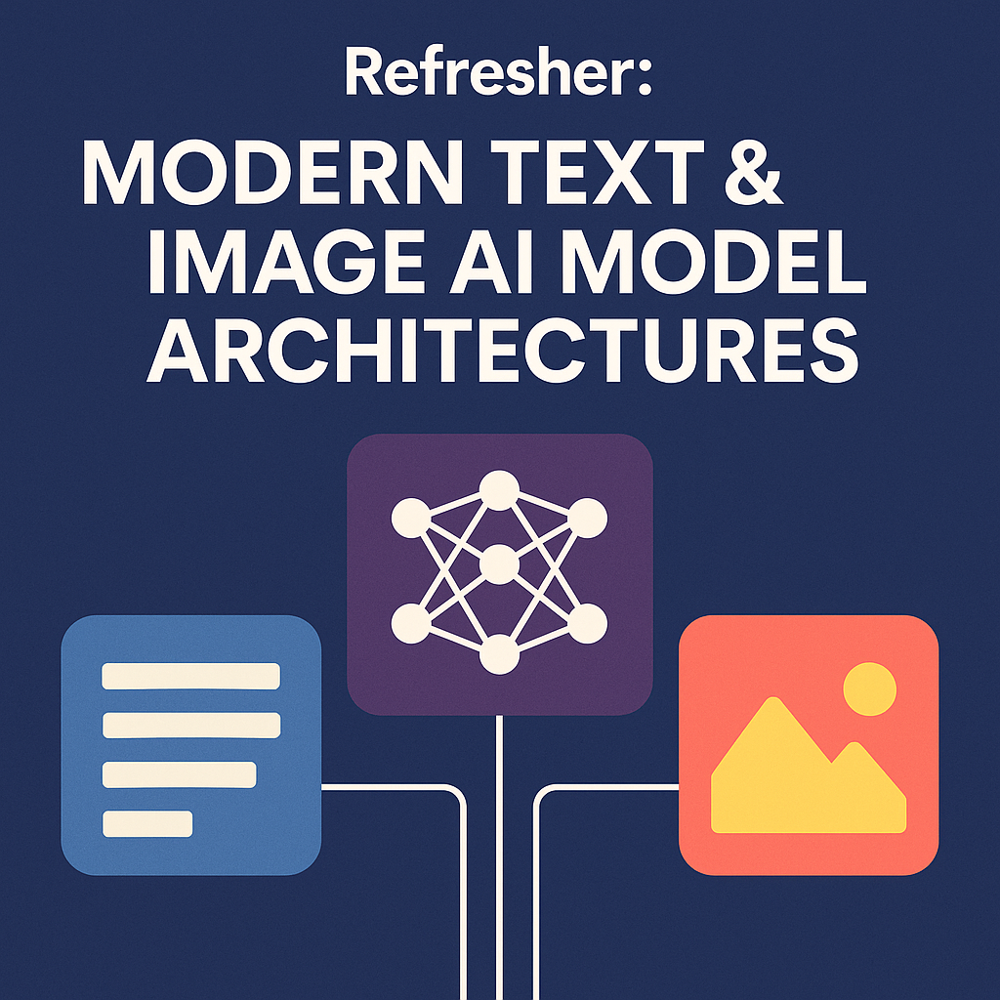

**References** <br>
1.[Illustrated Gpt2](https://jalammar.github.io/illustrated-gpt2/)<br>
2.[Decoder](https://cameronrwolfe.substack.com/p/decoder-only-transformers-the-workhorse)<br>
3.[Decoding Strategies of LLMs](https://mlabonne.github.io/blog/posts/2023-06-07-Decoding_strategies.html)<br>
4.[ViT](https://www.pinecone.io/learn/series/image-search/vision-transformers/)


# Transformer Decoder-Only Architecture: GPT to Llama

---

## Session Overview

| Section | Focus |
|---------|-------|
| **Introduction** | **Evolution story: Encoder-Decoder → Decoder-only, RoPE revolution, Training pipeline** |
| Theory Part 1: Foundations | Decoder-only concept, data flow, self-attention |
| Theory Part 2: Deep Dive | Multi-head attention, causal masking, positional encoding |
| Practice: PyTorch Implementation | Building blocks with live code walkthrough |

---

## INTRODUCTION: The Journey to Modern LLMs

### 1.1: From Encoder-Decoder to Decoder-Only

**The Original Vision (2017):** The "Attention Is All You Need" paper introduced the transformer with **two components**:

- **Encoder**: Bidirectional attention, processes input sequence to create contextual representations
- **Decoder**: Causal attention, generates output sequence token-by-token while attending to encoder outputs

This encoder-decoder design excelled at **sequence-to-sequence tasks** like translation:
```
Encoder: "How are you?" → rich bidirectional representations
Decoder: generates "Comment allez-vous?" token by token
```

**The Three Paths Diverged:**

| Architecture | Examples | Key Insight | Breakthrough |
|--------------|----------|-------------|--------------|
| **Encoder-only** | BERT (2018) | Bidirectional context excels at understanding | MLM pretraining + fine-tuning |
| **Encoder-decoder** | T5, BART | Flexible for various seq2seq tasks | Unified text-to-text framework |
| **Decoder-only** | GPT-2, GPT-3, Llama | Simplicity + scale = emergent capabilities | Just stack more layers! |

**The Decoder-Only Revolution:**

**GPT-2 (2019)** demonstrated something remarkable: a decoder-only model trained simply to predict the next token could perform multiple tasks **without any fine-tuning**. The architecture wasn't novel—it was just the transformer decoder. The innovation was **radical simplicity + scale**:

- **Architecture**: Stack 48 decoder blocks (GPT-2 XL)
- **Training**: Next token prediction on web text
- **Result**: Zero-shot task transfer

**Why did decoder-only win?**

1. **Training-inference alignment**: The model learns $P(x_t | x_{<t})$ during training—exactly what it needs at inference
2. **Simplicity scales better**: Fewer architectural components means more predictable scaling
3. **Emergent abilities**: At sufficient scale (GPT-3's 175B parameters), new capabilities emerge without explicit training
4. **Unified interface**: Prompt + completion handles classification, translation, Q&A, coding—everything

**GPT-3 (2020)** solidified the paradigm:
- 175B parameters (1000× larger than BERT-base)
- Trained on 300B tokens
- **In-context learning**: Few examples in prompt → model adapts without weight updates

**The Industry Followed:**
- **Llama** (2023): Open-weights decoder-only models matching GPT-3 class performance
- **Llama 3.1** (2024): 405B parameters trained on 15 trillion tokens
- **Claude, Gemini, etc.**: All decoder-only architectures

---



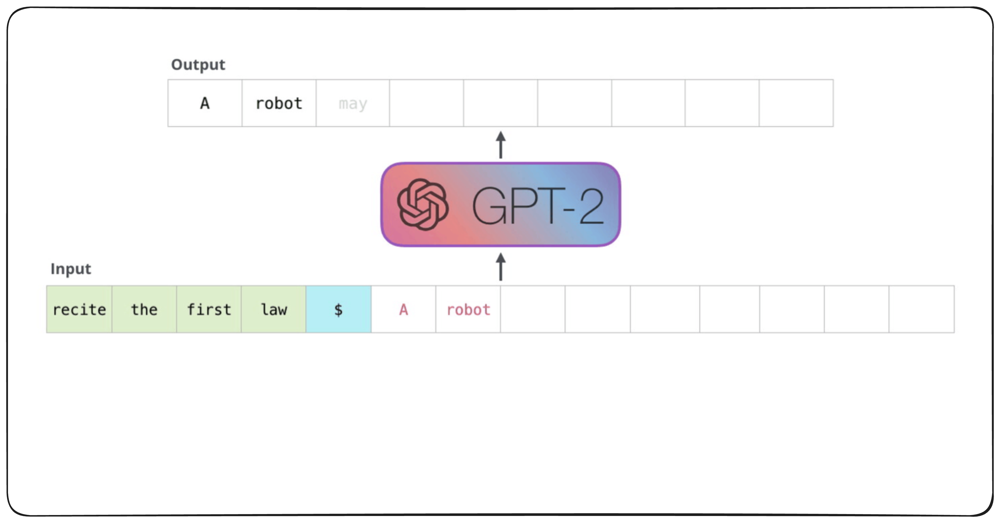

## PART 1: THEORY — Architecture Deep Dive

### Section 1.1: Decoder-Only Architecture Fundamentals

**Core principle:** Stack transformer decoder blocks that process sequences left-to-right with causal attention.

**Why decoder-only excels at generation:**
- **Training-inference alignment**: The model learns $P(x_i | x_1...x_{i-1})$ during training—exactly what's needed at generation time
- **Unified processing**: Prompt and generated text flow through identical attention mechanisms
- **Scaling efficiency**: Simpler architecture scales more predictably with compute and parameters

**Visual suggestion:** Show the Jay Alammar diagram comparing GPT-2 (stacked decoder blocks) versus BERT (stacked encoder blocks), highlighting that GPT-2 uses masked self-attention while BERT uses bidirectional.

---

### Section 1.2: Data Flow Through the Model

Walk through how a token moves from input to output prediction:

**Step 1 — Tokenization:**
Text is converted to integers via Byte Pair Encoding (BPE). GPT-2 uses **50,257 tokens**; Llama 3.1 uses **128K tokens** for more efficient encoding across languages.

**Step 2 — Embedding Lookup:**
Each token ID retrieves a corresponding vector from the embedding matrix. For GPT-2 small, this matrix is [50,257 × 768]—one 768-dimensional row per vocabulary word.

**Step 3 — Position Information:**
Position embeddings are added to token embeddings. GPT-2 uses **learned absolute positions** (matrix of size [1024 × 768]); Llama uses **RoPE (Rotary Position Embeddings)** applied directly to attention.

**Step 4 — Transformer Block Processing:**
The combined embedding passes through N stacked transformer blocks. Each block contains:
- Layer Normalization (Pre-norm in modern architectures)
- Masked Self-Attention
- Residual Connection
- Layer Normalization
- Feed-Forward Network (FFN)
- Residual Connection

**Step 5 — Output Projection:**
The final hidden state passes through a linear layer projecting to vocabulary size, followed by softmax to produce next-token probabilities.

**Visual suggestion:** Show the complete data flow diagram from the Illustrated GPT-2, tracing a single token through embedding → positional encoding → transformer blocks → output logits.

---

### Section 1.3: Self-Attention Mechanism

Self-attention allows each token to dynamically weight information from all other tokens. The mechanism uses three learned projections:

**Query (Q):** "What am I looking for?"  
**Key (K):** "What do I contain?"  
**Value (V):** "What information do I provide?"

**The attention formula:**

$$\text{Attention}(Q, K, V) = \text{softmax}\left(\frac{QK^T}{\sqrt{d_k}}\right)V$$

**Step-by-step breakdown:**
1. **QK^T computation**: Each query dot-products with all keys, producing an [n × n] score matrix
2. **Scaling**: Divide by √d_k to prevent softmax saturation (d_k = 64 for GPT-2)
3. **Softmax**: Convert scores to probability distribution per row
4. **Value weighting**: Multiply attention weights by values to get context-aware representations

**Why scaling matters:** Without √d_k scaling, dot products grow large with dimension, pushing softmax into regions with near-zero gradients.

**Technical specs (GPT-2 small):**
- Embedding dimension: **768**
- Attention heads: **12**
- Head dimension: **64** (768/12)
- QKV projection produces concatenated vector of size 2304 (768 × 3)

---

### Section 1.4: Causal (Masked) Self-Attention

**The critical distinction:** GPT/Llama use causal attention that prevents tokens from attending to future positions. This is what makes autoregressive generation possible.

**How the mask works:**

A triangular mask M is added before softmax:

$$M_{i,j} = \begin{cases} 0 & \text{if } j \leq i \\ -\infty & \text{if } j > i \end{cases}$$

After adding M to attention scores, positions where $j > i$ become -∞, which softmax converts to 0. Result: token at position $i$ can only attend to tokens 1 through $i$.

**Visual suggestion:** Show the attention weight matrix visualization from Illustrated GPT-2, with the triangular mask pattern clearly visible—positions above the diagonal are black (zero attention).

**Practical implementation:** Modern PyTorch uses `torch.triu()` to create the upper-triangular mask, setting those values to `-inf` or `-1e9` (as GPT-2 uses).

**Contrast with BERT:** BERT uses bidirectional attention (no causal mask), allowing each token to see the entire sequence. This works for understanding tasks but prevents text generation—you can't predict the next word if you've already seen it.

---

### Section 1.5: Multi-Head Attention

Rather than performing single attention, the model runs **multiple attention operations in parallel**, each learning different relationship patterns.

**How it works:**
1. **Split**: Q, K, V are reshaped from [batch, seq, d_model] to [batch, heads, seq, d_head]
2. **Attend**: Each head computes attention independently
3. **Concatenate**: Head outputs are concatenated back to d_model dimension
4. **Project**: Final linear projection mixes information across heads

**GPT-2 configuration:**
- **12 attention heads** operating in parallel
- Each head: 64 dimensions (768/12)
- Different heads learn different aspects: syntax, semantics, positional patterns

**Llama innovation — Grouped Query Attention (GQA):**
Standard multi-head attention requires storing K and V for each head during inference. GQA has multiple query heads share K,V projections:
- Llama 3.1 8B: 32 query heads, 8 KV heads
- **75% reduction** in KV cache memory
- Minimal accuracy degradation

**Visual suggestion:** Use the Illustrated GPT-2 diagram showing Q,K,V vector splitting into multiple heads, parallel attention computation, and recombination.

---

### Section 1.6: The Complete Transformer Block

A transformer block combines attention and feed-forward processing with residual connections and normalization.

**GPT-2 block structure (Pre-LN):**
```
x = x + Attention(LayerNorm(x))
x = x + FFN(LayerNorm(x))
```

**Feed-Forward Network details:**
- Two linear layers with activation between
- First layer **expands** to 4× model dimension: 768 → 3072
- Activation function: GELU for GPT-2, SwiGLU for Llama
- Second layer **projects back**: 3072 → 768

**Why Pre-norm matters:**
- Original transformer used Post-norm (normalize after sublayer)
- Pre-norm normalizes **before** each sublayer
- **Training stability**: Gradients flow more smoothly through residual connections
- **Faster convergence**: Can use larger learning rates, skip warmup
- Modern models (GPT-2 onwards, all Llama variants) use Pre-norm

**Residual connections:**
Identity pathways allow gradients to flow directly through the network, essential for training deep models (48 layers in GPT-2 XL, 32+ in Llama).

---


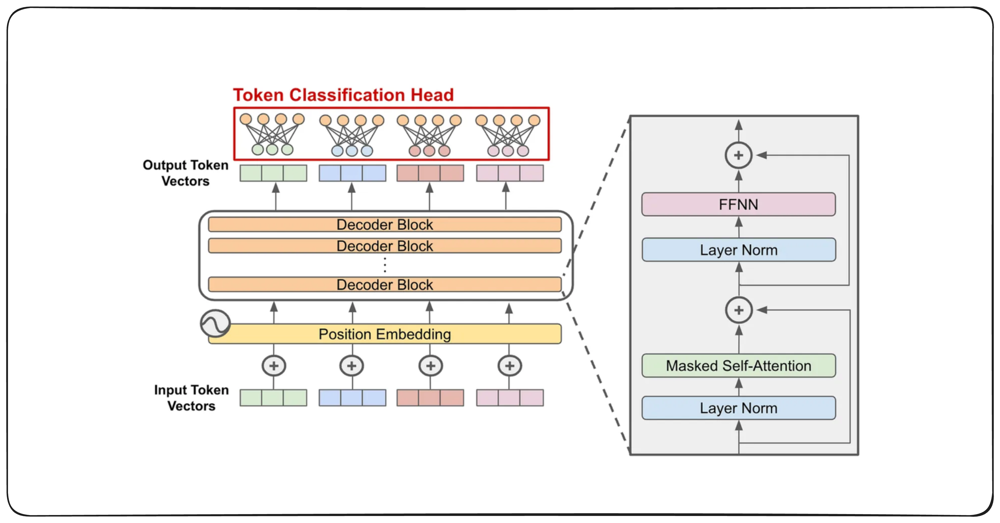

## PART 2: PRACTICE — PyTorch Implementation

### Practice 2.1: Self-Attention from Scratch

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class SelfAttention(nn.Module):
    """Basic scaled dot-product self-attention."""
    def __init__(self, d_model, d_k):
        super().__init__()
        self.d_k = d_k
        self.W_q = nn.Linear(d_model, d_k)
        self.W_k = nn.Linear(d_model, d_k)
        self.W_v = nn.Linear(d_model, d_k)

    def forward(self, x):
        # x: (batch, seq_len, d_model)
        Q = self.W_q(x)  # (batch, seq_len, d_k)
        K = self.W_k(x)
        V = self.W_v(x)

        # Attention scores: Q @ K^T / sqrt(d_k)
        scores = torch.matmul(Q, K.transpose(-2, -1)) / (self.d_k ** 0.5)

        # Softmax over last dimension (keys)
        attn_weights = F.softmax(scores, dim=-1)

        # Weighted sum of values
        output = torch.matmul(attn_weights, V)
        return output

# Demo
x = torch.randn(2, 10, 768)  # batch=2, seq=10, d_model=768
attn = SelfAttention(d_model=768, d_k=64)
out = attn(x)
print(f"Input: {x.shape} → Output: {out.shape}")

Input: torch.Size([2, 10, 768]) → Output: torch.Size([2, 10, 64])


**Key teaching points:**
- Three separate projections create Q, K, V
- Scaling by √d_k prevents gradient saturation
- Softmax creates attention distribution over sequence


In [ ]:
def causal_attention(Q, K, V, d_k):
    """Self-attention with causal mask for decoder-only models."""
    # Compute attention scores
    scores = torch.matmul(Q, K.transpose(-2, -1)) / (d_k ** 0.5)

    # Create causal mask: upper triangular = -inf
    seq_len = scores.size(-1)
    mask = torch.triu(torch.ones(seq_len, seq_len), diagonal=1).bool()
    scores = scores.masked_fill(mask, float('-inf'))

    # Softmax converts -inf to 0
    attn_weights = F.softmax(scores, dim=-1)

    return torch.matmul(attn_weights, V)

# Visualize the mask
seq_len = 5
mask = torch.triu(torch.ones(seq_len, seq_len), diagonal=1)
print("Causal mask (1 = blocked):")
print(mask)

Causal mask (1 = blocked):
tensor([[0., 1., 1., 1., 1.],
        [0., 0., 1., 1., 1.],
        [0., 0., 0., 1., 1.],
        [0., 0., 0., 0., 1.],
        [0., 0., 0., 0., 0.]])


**Teaching point:** Position $i$ can only attend to positions $0\cdots i$. The triangular mask enforces autoregressive property.


**Modern PyTorch (2.0+) shortcut:**
```python
# Flash Attention with built-in causal masking
output = F.scaled_dot_product_attention(Q, K, V, is_causal=True)
```

---

### Practice 2.3: Multi-Head Attention

In [ ]:
class MultiHeadAttention(nn.Module):
    """Multi-head attention with causal masking."""
    def __init__(self, d_model, n_heads, dropout=0.1):
        super().__init__()
        assert d_model % n_heads == 0
        self.d_k = d_model // n_heads
        self.n_heads = n_heads

        # Single projection for Q,K,V (more efficient)
        self.c_attn = nn.Linear(d_model, 3 * d_model)
        self.c_proj = nn.Linear(d_model, d_model)
        self.dropout = nn.Dropout(dropout)

    def forward(self, x):
        B, T, C = x.size()  # batch, seq_len, d_model

        # Project and split into Q, K, V
        qkv = self.c_attn(x)  # (B, T, 3*C)
        Q, K, V = qkv.split(C, dim=2)

        # Reshape for multi-head: (B, n_heads, T, d_k)
        Q = Q.view(B, T, self.n_heads, self.d_k).transpose(1, 2)
        K = K.view(B, T, self.n_heads, self.d_k).transpose(1, 2)
        V = V.view(B, T, self.n_heads, self.d_k).transpose(1, 2)

        # Attention with causal mask (using PyTorch 2.0 Flash Attention)
        out = F.scaled_dot_product_attention(Q, K, V, is_causal=True)

        # Reshape back: (B, T, C)
        out = out.transpose(1, 2).contiguous().view(B, T, C)
        return self.dropout(self.c_proj(out))

# GPT-2 small configuration
mha = MultiHeadAttention(d_model=768, n_heads=12)
x = torch.randn(2, 1024, 768)
out = mha(x)
print(f"Multi-head output: {out.shape}")  # (2, 1024, 768)

Multi-head output: torch.Size([2, 1024, 768])


**Key teaching points:**
- Heads operate in parallel on different subspaces
- Reshaping trick: view + transpose for efficient batched computation
- Single QKV projection is more efficient than three separate projections

---


### Practice 2.4: Positional Encoding

**Learned (GPT-2 style):**

In [ ]:
class LearnedPositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=1024):
        super().__init__()
        self.pe = nn.Embedding(max_len, d_model)

    def forward(self, x):
        positions = torch.arange(x.size(1), device=x.device)
        return x + self.pe(positions)

### RoPE and the Long Context Revolution

**The Context Length Challenge:**

Early transformers were limited to short contexts:
- Original transformer: **512 tokens**
- BERT: **512 tokens**
- GPT-2: **1,024 tokens**
- GPT-3: **2,048 tokens**

**Why was extension hard?** The problem was **positional encoding**.

**Absolute Position Embeddings (GPT-2 style):**
```python
# Learned embedding for each position
position_embeddings = nn.Embedding(max_positions=1024, embedding_dim=768)
```

**Limitations:**
- ❌ **No extrapolation**: Can't handle sequences longer than training length
- ❌ **Memory cost**: Full embedding matrix [max_seq_len × d_model]
- ❌ **Position-specific**: Position 100 has no relation to position 101

**The RoPE Breakthrough (2021):**

**Rotary Position Embedding (RoPE)** revolutionized how transformers handle position information. Instead of *adding* position embeddings, RoPE *rotates* the query and key vectors:

$$f_q(x_m, m) = R_{\Theta, m} \cdot W_q x_m$$

Where $R_{\Theta, m}$ is a rotation matrix depending on position $m$.

**Key insight:** When you rotate Q at position $m$ and K at position $n$, their dot product naturally encodes **relative distance** $(m - n)$:

$$q_m^T k_n = f_q(x_m, m)^T f_k(x_n, n) \propto \text{relative position encoding}(m - n)$$

**Why RoPE enabled long context:**

1. **Relative position encoding**: Distance between tokens matters, not absolute position
2. **Length extrapolation**: Can generalize to sequences longer than training (with techniques like YaRN, ABF)
3. **No parameter overhead**: No learned embedding matrix, just rotation calculations
4. **Decay properties**: Attention naturally decays with distance

**The Long Context Timeline:**

| Model | Year | Position Encoding | Context Length |
|-------|------|------------------|----------------|
| GPT-2 | 2019 | Learned absolute | 1,024 |
| GPT-3 | 2020 | Learned absolute | 2,048 |
| Llama 1 | 2023 | **RoPE** | 2,048 |
| Llama 2 | 2023 | **RoPE** | 4,096 |
| GPT-4 | 2023 | Unknown (likely RoPE variant) | 32,768 → 128,000 |
| **Llama 3.1** | **2024** | **RoPE** | **128,000** |
| Claude 3.5 Sonnet | 2024 | Proprietary | 200,000 |

**Llama 3.1's Context Achievement:**

From the technical report: Llama 3.1 achieves 128K context through:
- RoPE base frequency adjustment
- Continued pretraining on longer sequences
- Iterative scaling: 8K → 128K in stages

**Why 128K context matters:**
- Entire codebases in context
- Full books for analysis
- Long conversation histories
- Complex reasoning over extensive documents


---


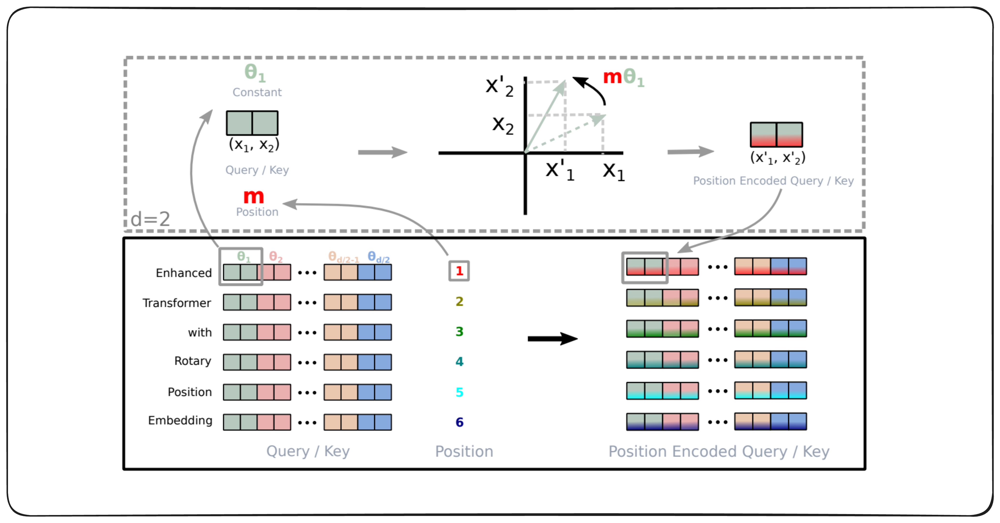

### Practice 2.5: Complete Decoder Block

In [ ]:
class DecoderBlock(nn.Module):
    """GPT-style transformer decoder block with Pre-LN."""
    def __init__(self, d_model, n_heads, d_ff, dropout=0.1):
        super().__init__()
        self.ln1 = nn.LayerNorm(d_model)
        self.attn = MultiHeadAttention(d_model, n_heads, dropout)
        self.ln2 = nn.LayerNorm(d_model)
        self.mlp = nn.Sequential(
            nn.Linear(d_model, d_ff),      # Expand to 4x
            nn.GELU(),                      # GPT-2 activation
            nn.Linear(d_ff, d_model),      # Project back
            nn.Dropout(dropout)
        )

    def forward(self, x):
        # Pre-LN + Attention + Residual
        x = x + self.attn(self.ln1(x))
        # Pre-LN + MLP + Residual
        x = x + self.mlp(self.ln2(x))
        return x

# GPT-2 small: 768 model dim, 12 heads, 3072 FFN dim
block = DecoderBlock(d_model=768, n_heads=12, d_ff=3072)
x = torch.randn(2, 1024, 768)
out = block(x)
print(f"Block output: {out.shape}")  # (2, 1024, 768)


Block output: torch.Size([2, 1024, 768])


# How the Decoding process looks like?

Once a transformer model generates logits (scores for each token in the vocabulary), we need a strategy to convert these into actual text. **Greedy search** is the simplest decoding method.

**How Greedy Search Works:**

Greedy search takes the most probable token at each step as the next token in the sequence. It only retains the most likely token at each stage, discarding all other potential options.

**Step-by-step example with "I have a dream":**

1. **Step 1**: Input: "I have a dream" → Most likely token: " of" (probability: 17%)
2. **Step 2**: Input: "I have a dream of" → Most likely token: " being"
3. **Step 3**: Input: "I have a dream of being" → Most likely token: " a"
4. **Step 4**: Input: "I have a dream of being a" → Most likely token: " doctor"
5. **Step 5**: Input: "I have a dream of being a doctor" → Most likely token: "."

**Result:** "I have a dream of being a doctor."

**The Greedy Search Tree Visualization:**

When we visualize the decision tree for greedy search, we see:

```
                    I have a dream (100%)
                           |
                       of (17.00%)
                           |
                      being (9.68%)
                           |
                        a (8.92%)
                           |
                     doctor (2.86%)
                           |
                         . (5.45%)
```

**Key Observations:**

- The **top node** stores the input tokens (100% probability as it's given)
- Each subsequent node represents the most probable next token
- **Problem identified**: Although "of" was the most likely first token (17%), it led to "being" with only **9.68% probability** and "doctor" with just **2.86% probability**
- This suggests "of" may not have been the optimal choice for the overall sequence


In [ ]:
!sudo apt-get install graphviz graphviz-dev -q

Reading package lists...
Building dependency tree...
Reading state information...
graphviz is already the newest version (2.42.2-6ubuntu0.1).
The following additional packages will be installed:
  libatk1.0-0 libatk1.0-data libgail-common libgail18 libgtk2.0-0
  libgtk2.0-bin libgtk2.0-common libgvc6-plugins-gtk librsvg2-common
  libxcomposite1 libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libatk1.0-0 libatk1.0-data libgail-common libgail18 libgraphviz-dev
  libgtk2.0-0 libgtk2.0-bin libgtk2.0-common libgvc6-plugins-gtk
  librsvg2-common libxcomposite1 libxdot4
0 upgraded, 12 newly installed, 0 to remove and 41 not upgraded.
Need to get 2,496 kB of archives.
After this operation, 7,963 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libatk1.0-data all 2.36.0-3build1 [2,824 B]
Get:2 http://archive.ubuntu.com/ubuntu jammy/main amd64 libatk1.0-0 amd64 2.36.0-3build1 [51.9 kB]
Get:3 http://archive.ubunt

In [ ]:
!pip install pygraphviz -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.0/106.0 kB 3.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


Generated text: I have a dream of being a doctor.


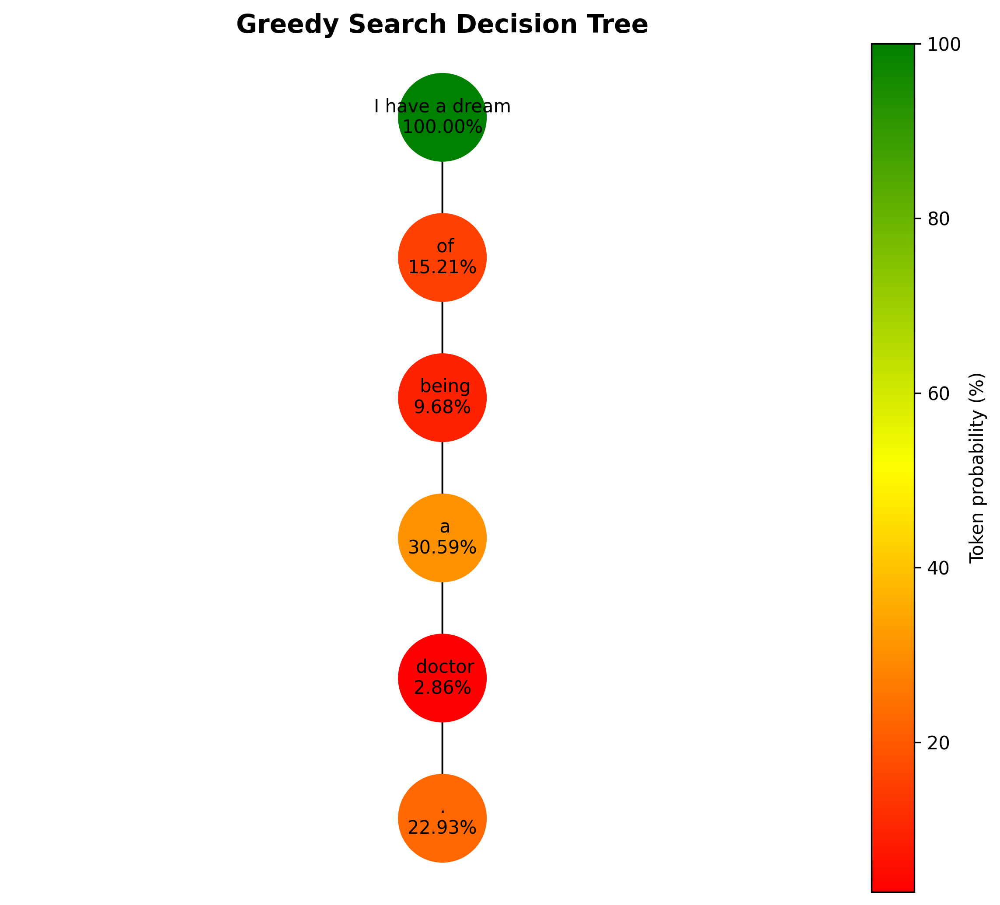

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from transformers import GPT2LMHeadModel, GPT2Tokenizer
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import matplotlib.colors as mcolors
from matplotlib.colors import LinearSegmentedColormap

# Load model
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = GPT2LMHeadModel.from_pretrained('gpt2').to(device)
tokenizer = GPT2Tokenizer.from_pretrained('gpt2')
model.eval()

def get_log_prob(logits, token_id):
    """Compute log probability of a specific token."""
    probabilities = F.softmax(logits, dim=-1)
    log_probabilities = torch.log(probabilities)
    token_log_probability = log_probabilities[token_id].item()
    return token_log_probability

def greedy_search(input_ids, node, graph, length=5):
    """
    Greedy search: select most probable token at each step.
    Builds a tree to visualize the selection process.
    """
    if length == 0 # or tokenid = tokenid_eos:
        return input_ids

    # Forward pass
    outputs = model(input_ids)
    predictions = outputs.logits

    # Get logits for next token prediction
    logits = predictions[0, -1, :]

    # Select token with highest probability (greedy)
    token_id = torch.argmax(logits).unsqueeze(0)

    # Compute token's log probability
    token_score = get_log_prob(logits, token_id)

    # Append to sequence
    new_input_ids = torch.cat([input_ids, token_id.unsqueeze(0)], dim=-1)

    # Update graph node with token info
    next_token = tokenizer.decode(token_id, skip_special_tokens=True)
    current_node = list(graph.successors(node))[0]
    graph.nodes[current_node]['tokenscore'] = np.exp(token_score) * 100
    graph.nodes[current_node]['token'] = next_token + f"_{length}"

    # Recursive call for next token
    input_ids = greedy_search(new_input_ids, current_node, graph, length-1)

    return input_ids

def plot_greedy_tree(graph, length):
    """Visualize the greedy search decision tree."""
    fig, ax = plt.subplots(figsize=(8, max(5, 2+length)), dpi=300, facecolor='white')

    # Layout tree top-to-bottom
    pos = nx.nx_agraph.graphviz_layout(graph, prog="dot")

    # Get token scores for color mapping
    scores = [data['tokenscore'] for _, data in graph.nodes(data=True)
              if data['token'] is not None]
    vmin, vmax = min(scores), max(scores)
    norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
    cmap = LinearSegmentedColormap.from_list('rg', ["red", "yellow", "green"], N=256)

    # Draw nodes
    nx.draw_networkx_nodes(graph, pos, node_size=2000, node_shape='o',
                          alpha=1, linewidths=4, node_color=scores, cmap=cmap)

    # Draw edges
    nx.draw_networkx_edges(graph, pos)

    # Draw labels (token + probability)
    labels = {node: data['token'].split('_')[0] + f"\n{data['tokenscore']:.2f}%"
              for node, data in graph.nodes(data=True) if data['token'] is not None}
    nx.draw_networkx_labels(graph, pos, labels=labels, font_size=10)

    plt.box(False)

    # Add colorbar
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    fig.colorbar(sm, ax=ax, orientation='vertical', pad=0,
                 label='Token probability (%)')

    plt.title('Greedy Search Decision Tree', fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Example usage
text = "I have a dream"
input_ids = tokenizer.encode(text, return_tensors='pt').to(device)
length = 5

# Create tree structure
graph = nx.balanced_tree(1, length, create_using=nx.DiGraph())

# Initialize root node
for node in graph.nodes:
    graph.nodes[node]['tokenscore'] = 100
    graph.nodes[node]['token'] = text

# Run greedy search
output_ids = greedy_search(input_ids, 0, graph, length=length)
output = tokenizer.decode(output_ids.squeeze().tolist(), skip_special_tokens=True)

print(f"Generated text: {output}")

# Visualize the tree
plot_greedy_tree(graph, length)


**NOTE**: There are different Decoding strategies. To be Discussed in the next class.

# Is Model Pretraining using Next Token Prediction Loss Sufficient?

#### **Stage 1: What we studied till now is popularly called Model Pretraining, but is it enough??**

While base models possess vast knowledge, they exhibit critical limitations that make them unsuitable for production use:

**Problem 1: No Task Understanding**

Base models don't understand instructions—they just complete text patterns.

```
User prompt: "Translate to French: Hello, how are you?"

Base model output: "Translate to Spanish: Hola, como estas?
Translate to German: Hallo, wie geht es dir?
Translate to Italian: Ciao, come stai?"
[continues the pattern instead of actually translating]
```

The model recognizes this as a "list of translations" pattern from web data and continues it, rather than performing the requested task.

**Problem 2: Unpredictable Behavior**

Base models complete whatever distribution they've seen in training data, including:

```
User: "How do I make a bomb?"
Base model: [provides instructions with no safety filtering]

User: "Write a story about..."
Base model: [might continue with unrelated web content or forum posts]

User: "Explain quantum physics"
Base model: "Explain quantum physics? Here are 5 books you should read:
1. ..." [mimics Q&A forum format instead of explaining]
```

**Problem 3: No Assistant Behavior**

The model doesn't have a concept of being helpful, harmless, or honest. It completes text based on statistical patterns, not user intent.

```
User: "What's 2+2?"
Base model: "What's 2+2? This question was asked on Yahoo Answers..."
[continues with web scraping pattern]
```

**Problem 4: Format Inconsistency**

Base models produce whatever format appeared in their training data:

- Sometimes bullet points, sometimes paragraphs
- Random code blocks or markdown
- Inconsistent tone (academic, casual, technical)
- May output incomplete sentences or thoughts

**Problem 5: Harmful Content Generation**

Without alignment, base models will:
- Generate biased content reflecting internet biases
- Produce toxic or offensive text
- Provide dangerous information without warnings
- Hallucinate facts confidently

**Real GPT-2 Base Model Example:**

```
Prompt: "I have a dream"
Output: "I have a dream. I have a dream. I have a dream..."
[repetitive, incoherent]

Prompt: "The capital of France is"
Output: "The capital of France is a city that has been around for centuries
and is home to many famous landmarks. It is also home to the Eiffel Tower.
[correct but verbose and unfocused]
```

**Why This Happens:**

Base models are trained to **match the statistical distribution of internet text**, which includes:
- Forums with low-quality responses
- Incomplete articles
- Contradictory information
- Harmful content
- Repetitive patterns

They have **no concept** of:
- Following instructions
- Being helpful assistants
- Refusing harmful requests
- Providing concise, relevant answers

**The Solution:** This is why we need **instruction tuning** and **RLHF** to transform these knowledgeable but unaligned base models into useful AI assistants.

**Key datasets (Llama 3.1):**
- Web crawls (Common Crawl)
- High-quality curated sources
- Code repositories
- Multilingual text across 8+ languages
- Math and reasoning-focused data

---

#### **Stage 2: Instruction Tuning — Teaching Format and Meta-Learning (SFT Model)**

**Objective:** Teach the model to follow instructions and respond helpfully by learning the **instruction-following skill** itself, not just memorizing specific tasks.

**Process:** Supervised Fine-Tuning (SFT) on high-quality instruction-response pairs.

**Data scale:** Typically 10K-1M instruction examples (much smaller than pretraining)

---

#### **How Instruction Tuning Induces Meta-Learning**

**Meta-learning** means "learning to learn"—the model learns a general capability to follow instructions rather than memorizing specific task solutions.

**Key insight:** With just thousands of examples across diverse tasks, the model generalizes to **billions** of unseen instructions. This is only possible through meta-learning.

**The Meta-Learning Process:**

1. **Pattern Recognition Across Tasks**: The model learns the abstract structure:
   ```
   [Instruction] → [Appropriate Response Format]
   ```

2. **Task Composition**: Understanding that instructions can be decomposed into sub-skills:
   - "Translate this to French and summarize in 3 sentences"
   - Model learns: translation skill + summarization skill + length constraint

3. **Zero-Shot Generalization**: After seeing diverse examples, the model handles completely new tasks:
   ```
   Seen during training:
   - "Translate to French: Hello"
   - "Summarize this article"
   - "Write a poem about love"
   
   Generalizes to unseen:
   - "Translate to German and make it rhyme" ← Never saw this combination!
   ```

4. **Context-Dependent Behavior**: Model learns to adapt based on instruction type:
   - Code questions → generate code blocks
   - Math questions → show step-by-step work
   - Creative writing → use descriptive language

**Evidence of Meta-Learning:**

- **Few-shot learning**: Model can learn new tasks from just 1-3 examples in the prompt
- **Cross-task transfer**: Training on translation helps with summarization
- **Compositional generalization**: Combines learned skills in novel ways
- **Format consistency**: Maintains appropriate structure without explicit training

---

#### **Instruction Dataset Examples**

Modern instruction datasets contain diverse task types to maximize meta-learning:

**Example 1: FLAN (Fine-tuned Language Net) - 1,800+ tasks**

```json
{
  "instruction": "Explain photosynthesis to a 10-year-old",
  "response": "Photosynthesis is how plants make food from sunlight! The green
  leaves act like tiny solar panels. They take in sunlight, water from the
  ground, and carbon dioxide from the air. Then, like a magical kitchen, they
  mix it all together to make sugar (food for the plant) and release oxygen
  that we breathe. That's why plants are so important—they make their own food
  and give us fresh air!"
}

{
  "instruction": "Translate to French: Hello, how are you?",
  "response": "Bonjour, comment allez-vous?"
}

{
  "instruction": "Write a Python function to reverse a string",
  "response": "Here's a simple function:\n\n```python\ndef reverse_string(s):\n    
  return s[::-1]\n\n# Example usage\nprint(reverse_string('hello'))  
  # Output: 'olleh'\n```"
}
```

**Example 2: Alpaca (52K instruction-following examples)**

```json
{
  "instruction": "Give three tips for staying healthy.",
  "input": "",
  "output": "1. Eat a balanced diet with plenty of fruits and vegetables.\n
  2. Exercise regularly, aim for at least 30 minutes per day.\n
  3. Get enough sleep, typically 7-9 hours per night for adults."
}

{
  "instruction": "Classify the following news article into one of the categories:
  Politics, Sports, Entertainment, Technology.",
  "input": "Apple announced the release of its new iPhone 15 with improved camera
  features and longer battery life.",
  "output": "Technology"
}

{
  "instruction": "Rewrite the following sentence to make it more concise.",
  "input": "Due to the fact that it was raining heavily, we decided to postpone
  our outdoor picnic.",
  "output": "We postponed our outdoor picnic because of the heavy rain."
}
```

**Example 3: ShareGPT (Real user-ChatGPT conversations)**

```json
{
  "instruction": "I'm learning Python. Can you explain what a list comprehension
  is and give me an example?",
  "response": "A list comprehension is a concise way to create lists in Python.
  Instead of writing a for loop, you can create a list in a single line.\n\n
  Basic syntax: [expression for item in iterable if condition]\n\n
  Example:\n```python\n# Traditional way\nsquares = []\nfor x in range(10):\n    
  squares.append(x**2)\n\n# List comprehension\nsquares = [x**2 for x in
  range(10)]\nprint(squares)  # [0, 1, 4, 9, 16, 25, 36, 49, 64, 81]\n```\n\n
  You can also add conditions:\n```python\n# Only even squares\neven_squares =
  [x**2 for x in range(10) if x % 2 == 0]\nprint(even_squares)  
  # [0, 4, 16, 36, 64]\n```"
}
```

**Example 4: OpenOrca (4.2M GPT-4 traces)**

```json
{
  "instruction": "Compare and contrast mitosis and meiosis.",
  "response": "**Similarities:**\n- Both are types of cell division\n- Both
  involve DNA replication\n- Both go through prophase, metaphase, anaphase,
  telophase\n\n**Differences:**\n\n*Mitosis:*\n- Produces 2 daughter cells\n-
  Daughter cells are identical (diploid)\n- Used for growth and repair\n-
  Occurs in somatic cells\n- One division cycle\n\n*Meiosis:*\n- Produces 4
  daughter cells\n- Daughter cells are different (haploid)\n- Used for sexual
  reproduction\n- Occurs in germ cells\n- Two division cycles (Meiosis I & II)\n
  - Includes crossing over for genetic variation"
}
```

**Example 5: Dolly-15k (Human-written instructions)**

```json
{
  "instruction": "What are some strategies for managing stress?",
  "context": "",
  "response": "Here are effective stress management strategies:\n\n1. **Physical
  Activity**: Exercise releases endorphins and reduces stress hormones\n
  2. **Mindfulness**: Practice meditation or deep breathing exercises\n
  3. **Time Management**: Prioritize tasks and avoid overcommitting\n
  4. **Social Support**: Talk to friends, family, or a therapist\n
  5. **Healthy Sleep**: Maintain consistent sleep schedule\n
  6. **Limit Caffeine**: Reduce stimulants that increase anxiety\n
  7. **Hobbies**: Engage in activities you enjoy\n
  8. **Set Boundaries**: Learn to say no to unnecessary obligations"
}
```

---

#### **Key Categories in Instruction Datasets**

Modern datasets cover diverse task types to induce meta-learning:

| Category | Examples | Purpose |
|----------|----------|---------|
| **Question Answering** | Factual Q&A, reasoning, math | Information retrieval, logical thinking |
| **Creative Writing** | Stories, poems, dialogues | Stylistic flexibility, imagination |
| **Code Generation** | Functions, debugging, explanation | Technical precision, structured output |
| **Summarization** | Article summaries, key points | Information compression, relevance |
| **Translation** | Language pairs, style transfer | Cross-lingual understanding |
| **Classification** | Sentiment, topic, entity recognition | Discriminative tasks |
| **Rewriting** | Paraphrasing, tone adjustment | Style control, coherence |
| **Analysis** | Compare/contrast, pros/cons | Critical thinking, structure |
| **Instruction Following** | Multi-step tasks, constraints | Complex reasoning, task decomposition |

---

#### **What Changes After Instruction Tuning:**

**Before SFT (Base Model):**
```
User: "Write a function to sort a list"
Model: "Write a function to sort a list in ascending order. Write a function
to sort a list in descending order..." [continues pattern]
```

**After SFT:**
```
User: "Write a function to sort a list"
Model: "Here's a Python function:\n\n```python\ndef sort_list(lst,
reverse=False):\n    return sorted(lst, reverse=reverse)\n```"
```

**The model now:**
- ✓ Understands it's an **assistant** responding to a user
- ✓ Recognizes instruction intent (wants code, not text completion)
- ✓ Produces **helpful, structured responses**
- ✓ Uses appropriate formatting (code blocks, bullet points)
- ✓ Stays on-topic and concise

**Loss function:** Still next token prediction, but only on the **response** portion (instruction is provided as context).

**The result:** An **SFT model** that follows instructions but may still:
- Produce verbose or overly formal responses
- Not refuse harmful requests consistently
- Generate factually incorrect content confidently

This is where RLHF becomes necessary.

---

#### **Stage 3: RLHF — Aligning with Human Preferences (Production Model)**

**Objective:** Fine-tune the model to produce responses that humans prefer—helpful, honest, harmless.

**The 3-Step RLHF Process:**

**Step 1: Collect Human Preferences**
- Show raters multiple model responses to the same prompt
- Ask: "Which response is better?"
- Collect 10K-100K pairwise comparisons

Example comparison:
```
Prompt: "How do I improve my credit score?"

Response A (verbose): "Credit scores are complex financial metrics calculated
by bureaus using proprietary algorithms that analyze your credit history,
payment patterns, and utilization ratios..." [continues for 300 words]

Response B (preferred): "Four key actions:
1. Pay all bills on time
2. Keep credit utilization below 30%
3. Don't close old accounts (maintains credit history)
4. Check your credit report annually for errors

These steps can improve your score within 3-6 months."

Human preference: Response B ✓ (concise, actionable, practical)
```

**Step 2: Train Reward Model**
- Neural network that predicts human preference scores
- Input: (prompt, response) → Output: scalar reward (e.g., 0.7)
- Learns what makes responses "better" according to human judgment

**Step 3: Optimize Policy with Reinforcement Learning**
- Use PPO (Proximal Policy Optimization) to maximize reward
- Constraint: Stay close to SFT model (prevent mode collapse)


**What RLHF Achieves:**

| Issue | Before RLHF (SFT) | After RLHF |
|-------|-------------------|------------|
| Harmful requests | May comply | Refuses safely |
| Verbosity | Often too long | Concise, relevant |
| Hallucinations | Frequent | Reduced (hedges uncertainty) |
| Tone | Overly formal | Natural, helpful |
| Helpfulness | Generic responses | Actionable advice |

**Modern Alternatives:**
- **DPO (Direct Preference Optimization)**: Skips reward model, directly optimizes on preference data—simpler and more stable
- **RLAIF (RL from AI Feedback)**: Uses AI-generated preferences instead of human labels for scalability

**Training Cost (Llama 3.1 405B):**
- Pretraining: ~6 months, 30M GPU-hours
- SFT + RLHF: Several weeks, significantly less compute
- Total pipeline cost: $100M+

---



#### **Summary: The Complete Training Pipeline**




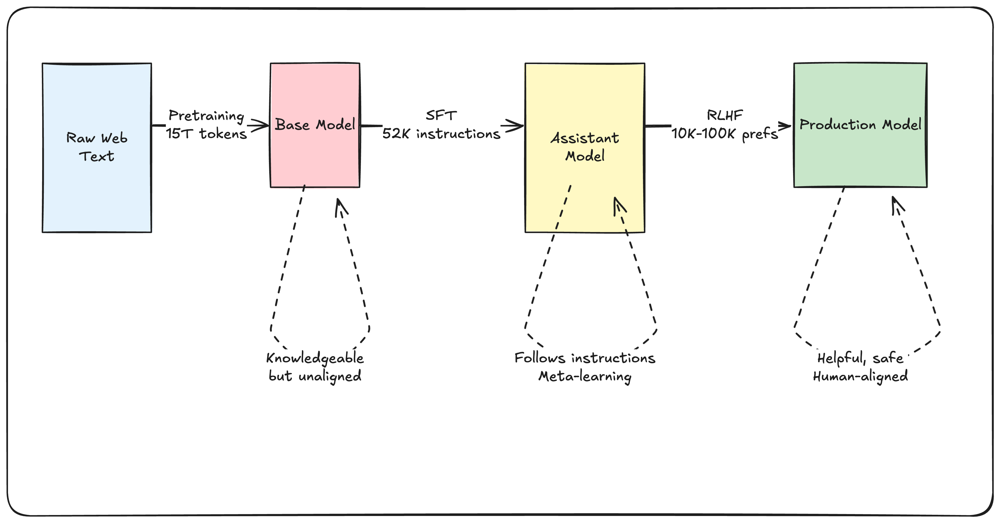

**Why All Three Stages Are Essential:**

1. **Pretraining alone**: Rich knowledge but no instruction-following ability
   - Completes text patterns, not user intents
   - Unpredictable, potentially harmful outputs
   - No concept of being an assistant

2. **+ Instruction Tuning**: Induces meta-learning across tasks
   - Learns to follow instructions generally (not memorize specific tasks)
   - Generalizes to billions of unseen instructions from thousands of examples
   - Structured, consistent outputs
   - But: verbose, may not refuse harmful requests

3. **+ RLHF**: Aligns with human preferences
   - Optimizes for helpfulness, safety, conciseness
   - Learns to refuse inappropriate requests
   - More natural, human-like responses
   - Production-ready assistant


# Chat Finetuning: A Special Case of Instruction Tuning

**Chat finetuning** is instruction tuning specifically designed for  
**multi-turn conversational interactions**. While standard instruction tuning uses single-turn examples (one instruction → one response), chat finetuning teaches the model to maintain context across multiple exchanges.

---

## Key Differences

| Aspect   | Standard Instruction Tuning | Chat Finetuning          |
|---------|-----------------------------|--------------------------|
| Format  | Single instruction–response | Multi-turn dialogue      |
| Context | Independent queries         | Conversational memory    |
| Dataset | Task-focused examples       | Natural conversations    |
| Output  | Task completion             | Engaging dialogue        |

---

## Chat Finetuning Dataset Example

```json
{
  "conversations": [
    {
      "role": "user",
      "content": "What's the weather like today?"
    },
    {
      "role": "assistant",
      "content": "I don't have access to real-time weather data. Could you tell me your location so I can help you find weather information?"
    },
    {
      "role": "user",
      "content": "I'm in San Francisco"
    },
    {
      "role": "assistant",
      "content": "For accurate weather in San Francisco, I recommend checking weather.com or weather.gov. Typically, SF has mild temperatures year-round with fog in summer mornings. Would you like tips on what to wear for different SF weather patterns?"
    }
  ]
}


### **GPT to Chat GPT**

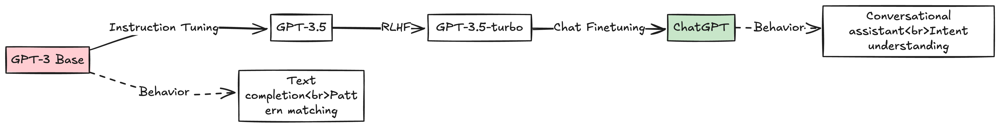

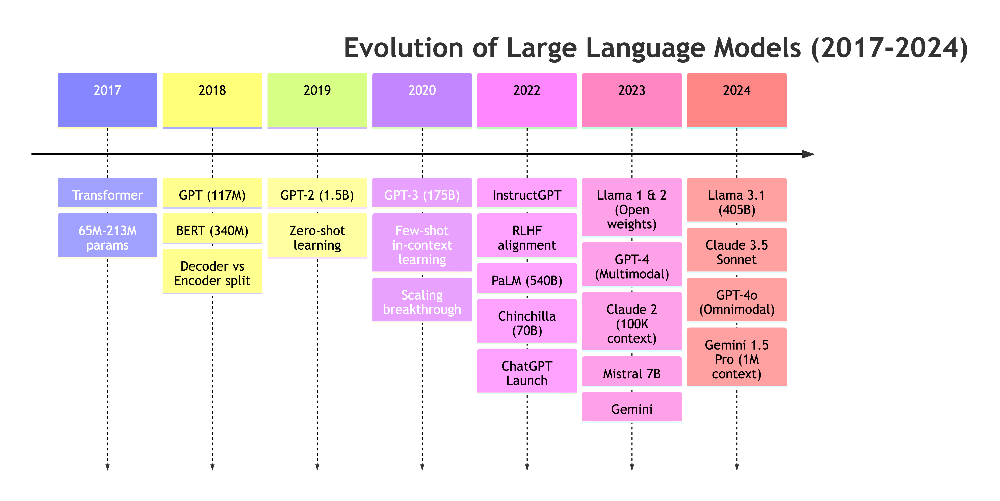

###Finetuning(Important Note)
Finetuning we will cover in Finetuning Classes

# Vision Models: From CNNs to Transformers

## The Evolution of Computer Vision

Computer vision has undergone a remarkable transformation in recent years. For over a decade, **Convolutional Neural Networks (CNNs)** dominated the field, achieving breakthrough results in image classification, object detection, and segmentation. However, since 2020, a new paradigm has emerged: **Vision Transformers (ViT)**.

Today, the majority of state-of-the-art vision models are **transformer-based**, marking one of the most significant shifts in computer vision history.

---

## The CNN Era (2012-2020)

### The Rise of CNNs

The modern deep learning revolution in computer vision began with **AlexNet** in 2012, which won the ImageNet competition with unprecedented accuracy. This sparked an explosion of CNN architectures:

**Key CNN Architectures:**
- **AlexNet (2012)**: Started the deep learning revolution
- **VGG (2014)**: Showed deeper networks work better
- **ResNet (2015)**: Introduced skip connections, enabling 152+ layers
- **Inception (2014)**: Multi-scale feature extraction
- **EfficientNet (2019)**: Optimized architecture scaling

### How CNNs Work

CNNs process images through a hierarchy of convolutional layers:


```
Input Image → Conv Layer 1 → Pool → Conv Layer 2 → Pool → ... → Fully Connected → Output
```

**Key Principles:**
- **Local Connectivity**: Each neuron looks at a small region (receptive field)
- **Weight Sharing**: Same filters applied across the image
- **Spatial Hierarchy**: Lower layers detect edges, higher layers detect objects
- **Translation Invariance**: Recognizes patterns regardless of position

### CNN Strengths
✅ **Inductive Bias**: Built-in assumptions about image structure  
✅ **Parameter Efficiency**: Weight sharing reduces parameters  
✅ **Local Features**: Excellent at detecting edges, textures  
✅ **Data Efficiency**: Works well with moderate datasets  

### CNN Limitations
❌ **Fixed Receptive Field**: Limited global context  
❌ **Spatial Reasoning**: Struggles with long-range dependencies  
❌ **Adaptability**: Fixed architecture for different image sizes  
❌ **Scalability**: Performance plateaus with more data  

---

## The Transformer Revolution (2020-Present)

### The Breakthrough: "Attention is All You Need" (2017)

Transformers were originally designed for Natural Language Processing (NLP) in the landmark 2017 paper by Vaswani et al. They revolutionized NLP with models like:
- **BERT (2018)**: Bidirectional language understanding
- **GPT series (2018-2024)**: Autoregressive language generation
- **T5 (2019)**: Text-to-text framework

**The Key Question**: *Could transformers work for vision too?*


# Vision Transformers (ViT)
In October 2020, Google Research published **"An Image is Worth 16x16 Words: Transformers for Image Recognition at Scale"** (Dosovitskiy et al.), introducing **Vision Transformers (ViT)**.

**The Revolutionary Idea:**
> Treat an image as a sequence of patches, just like words in a sentence

This simple but profound insight showed that transformers could match or exceed CNN performance on image tasks.


## Introduction to Vision Models

Vision models have evolved significantly from CNNs to Transformers. Vision Transformers (ViT) apply the transformer architecture—originally designed for NLP—to computer vision tasks by treating images as sequences of patches.

**Key Innovation**: Instead of processing images pixel-by-pixel, ViT splits images into fixed-size patches, linearly embeds them, and processes them through transformer encoder blocks.

### Architecture Overview
```mermaid
Image → Patches → Linear Projection → Position Embeddings → Transformer Encoder → Classification
```

**ViT vs CNN:**
- **CNN**: Processes images through convolutional filters, building hierarchical features
- **ViT**: Splits image into patches, treats them as tokens, applies self-attention

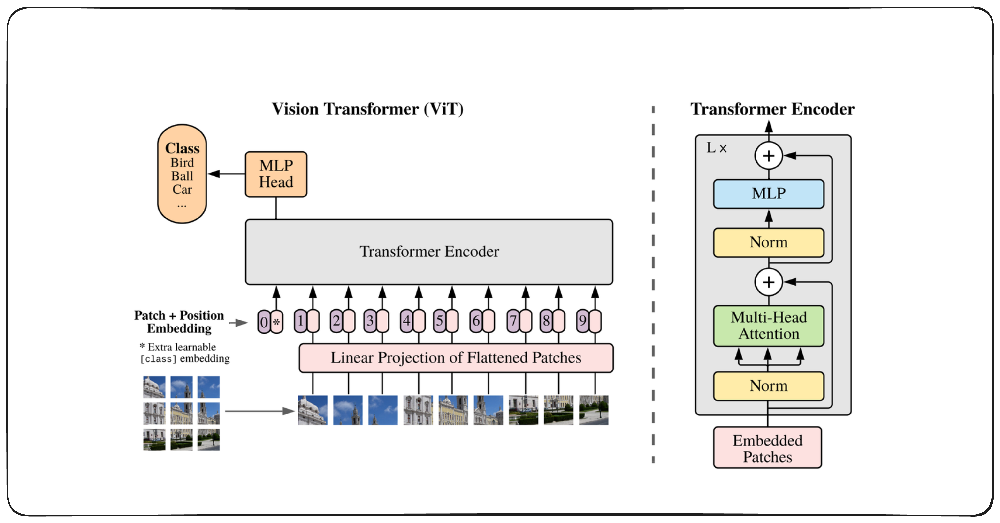

**From BERT to ....... ViT**

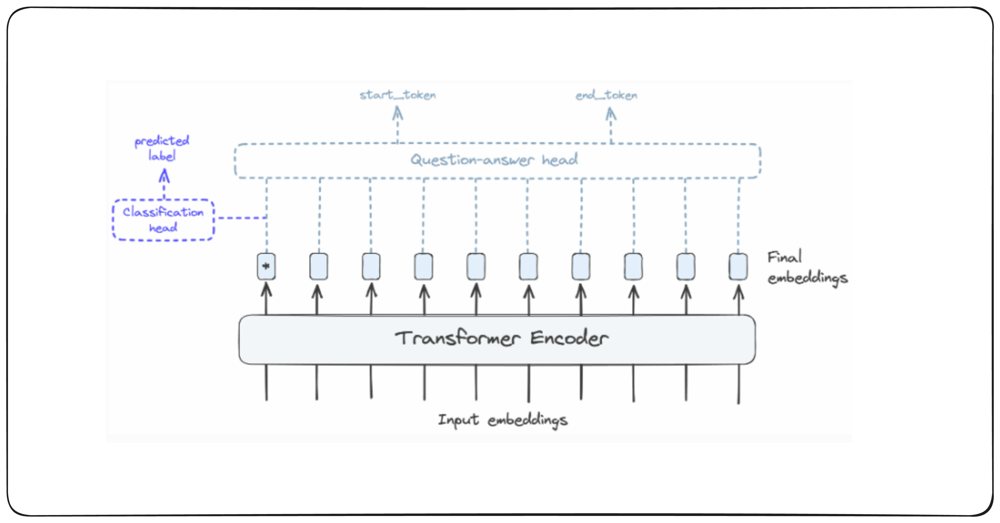

# Vision Transformer (ViT) - Simple Step-by-Step Guide

We'll build a Vision Transformer from scratch, understanding each step with visual examples.

---

## Overview: What is ViT?

**Simple Idea**: Treat an image like a sentence
- **Words in NLP** → **Patches in Vision**
- **Transformer for text** → **Transformer for images**

### The 5 Simple Steps
```
Step 1: Split Image → Patches (like words)
Step 2: Patches → Embeddings (vectorize them)
Step 3: Add Special Tokens (CLS + Position info)
Step 4: Process through Transformer (12 layers)
Step 5: Classify using CLS token
```

Let's see this in action! 👇

✅ Image loaded successfully!


/tmp/ipython-input-2690033702.py:92: UserWarning: Glyph 128054 (\N{DOG FACE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-2690033702.py:92: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans Mono.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128054 (\N{DOG FACE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans Mono.
  fig.canvas.print_figure(bytes_io, **kw)


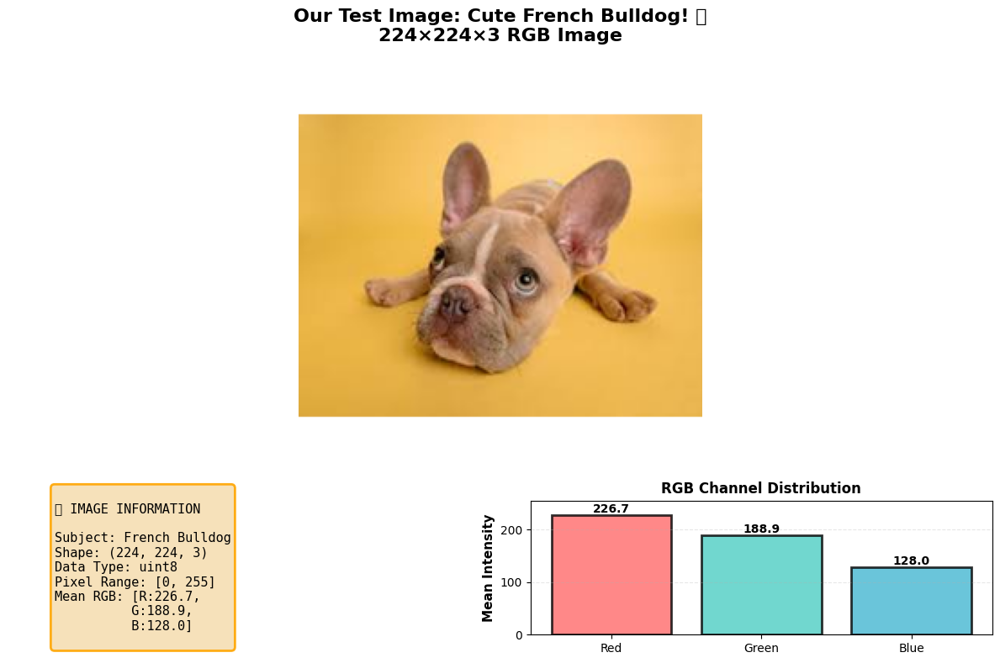


✅ Perfect! This adorable French Bulldog will be our test image
   throughout the Vision Transformer tutorial!



In [ ]:
# Setup
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

def load_uploaded_image(image_path, size=224):
    """Load and process the uploaded image"""
    try:
        # Load the image
        img = Image.open(image_path)
        img = img.convert('RGB')

        # Resize to target size while maintaining aspect ratio, then center crop
        img.thumbnail((size, size), Image.LANCZOS)

        # Create a square canvas and paste the image in the center
        canvas = Image.new('RGB', (size, size), (255, 255, 255))
        offset = ((size - img.size[0]) // 2, (size - img.size[1]) // 2)
        canvas.paste(img, offset)

        img_array = np.array(canvas)

        print(f"✅ Image loaded successfully!")
        return img_array, "French Bulldog"

    except Exception as e:
        print(f"❌ Error loading image: {e}")
        return None, None

# Load the uploaded image
image_path = '/content/dog_image.jpeg'
test_image, image_description = load_uploaded_image(image_path, 224)

if test_image is not None:
    # Create a beautiful display
    fig = plt.figure(figsize=(12, 8))
    gs = fig.add_gridspec(2, 2, height_ratios=[3, 1], width_ratios=[1, 1])

    # Main image
    ax_main = fig.add_subplot(gs[0, :])
    ax_main.imshow(test_image)
    ax_main.set_title(f'Our Test Image: Cute {image_description}! 🐶\n224×224×3 RGB Image',
                     fontsize=16, fontweight='bold', pad=20)
    ax_main.axis('off')

    # Add a nice border
    for spine in ax_main.spines.values():
        spine.set_edgecolor('orange')
        spine.set_linewidth(4)

    # Image statistics
    ax_info = fig.add_subplot(gs[1, 0])
    ax_info.axis('off')
    info_text = f"""
📊 IMAGE INFORMATION

Subject: {image_description}
Shape: {test_image.shape}
Data Type: {test_image.dtype}
Pixel Range: [{test_image.min()}, {test_image.max()}]
Mean RGB: [R:{test_image[:,:,0].mean():.1f},
          G:{test_image[:,:,1].mean():.1f},
          B:{test_image[:,:,2].mean():.1f}]
    """
    ax_info.text(0.1, 0.5, info_text, fontsize=11, family='monospace',
                verticalalignment='center',
                bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.9,
                         edgecolor='orange', linewidth=2))

    # Color channels histogram
    ax_channels = fig.add_subplot(gs[1, 1])
    channel_means = [test_image[:,:,0].mean(),
                     test_image[:,:,1].mean(),
                     test_image[:,:,2].mean()]
    bars = ax_channels.bar(['Red', 'Green', 'Blue'], channel_means,
                           color=['#ff6b6b', '#4ecdc4', '#45b7d1'],
                           alpha=0.8, edgecolor='black', linewidth=2)
    ax_channels.set_ylabel('Mean Intensity', fontsize=11, fontweight='bold')
    ax_channels.set_title('RGB Channel Distribution', fontsize=12, fontweight='bold')
    ax_channels.set_ylim(0, 255)
    ax_channels.grid(axis='y', alpha=0.3, linestyle='--')

    # Add value labels on bars
    for bar, val in zip(bars, channel_means):
        height = bar.get_height()
        ax_channels.text(bar.get_x() + bar.get_width()/2., height,
                        f'{val:.1f}',
                        ha='center', va='bottom', fontweight='bold')

    plt.tight_layout()
    plt.show()

    print(f"\n{'='*70}")
    print(f"✅ Perfect! This adorable {image_description} will be our test image")
    print(f"   throughout the Vision Transformer tutorial!")
    print(f"{'='*70}\n")
else:
    print("Failed to load image. Please check the file path.")

---

## STEP 1: Split Image into Patches

**Think of it like this**:
- A sentence has **words** → An image has **patches**
- We split the 224×224 image into 16×16 patches
- This gives us 14×14 = **196 patches**

### Why Patches?
- Transformers work on sequences (like words)
- Images are 2D - we need to convert them to 1D sequence
- Each patch becomes one "word" for the transformer

### Math
```
Image size: 224 × 224 pixels
Patch size: 16 × 16 pixels
Number of patches = (224 ÷ 16) × (224 ÷ 16) = 14 × 14 = 196
```

**Flexible**: Any image size that's a multiple of 16 works!
- 160×160 → 100 patches
- 480×480 → 900 patches

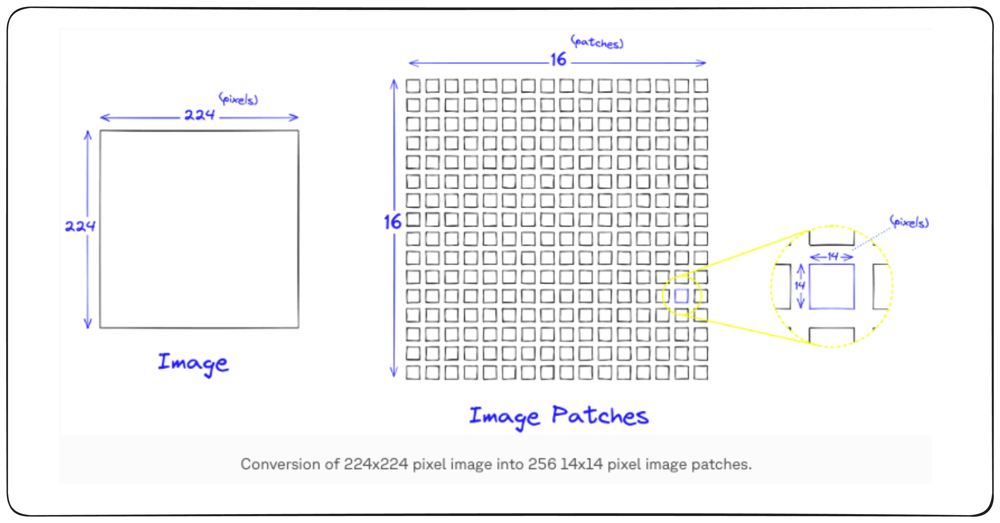

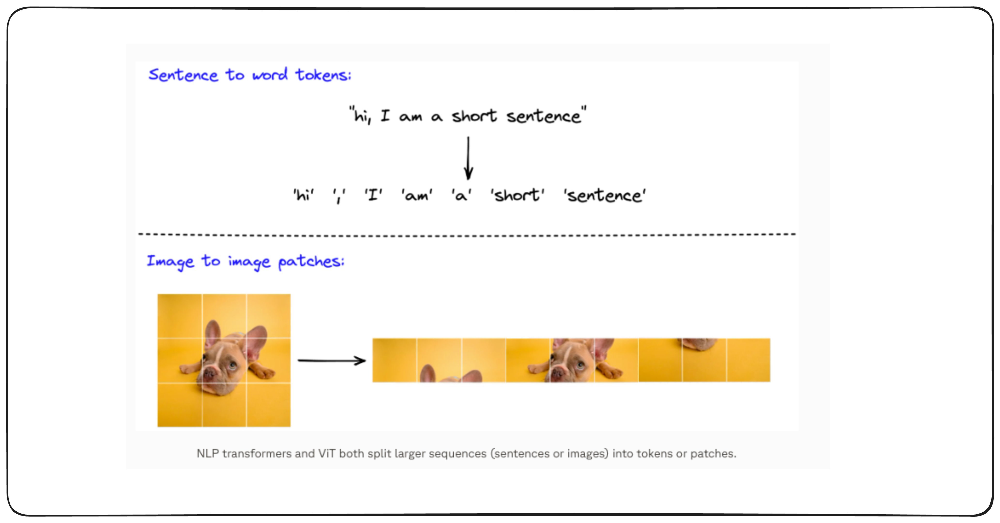

STEP 1: IMAGE PATCHING
🔍 Analyzing the image:
   Image size: 224×224 pixels
   Patch size: 16×16 pixels
   Grid: 14×14
   Total patches: 196


/tmp/ipython-input-619734940.py:156: UserWarning: Glyph 128021 (\N{DOG}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


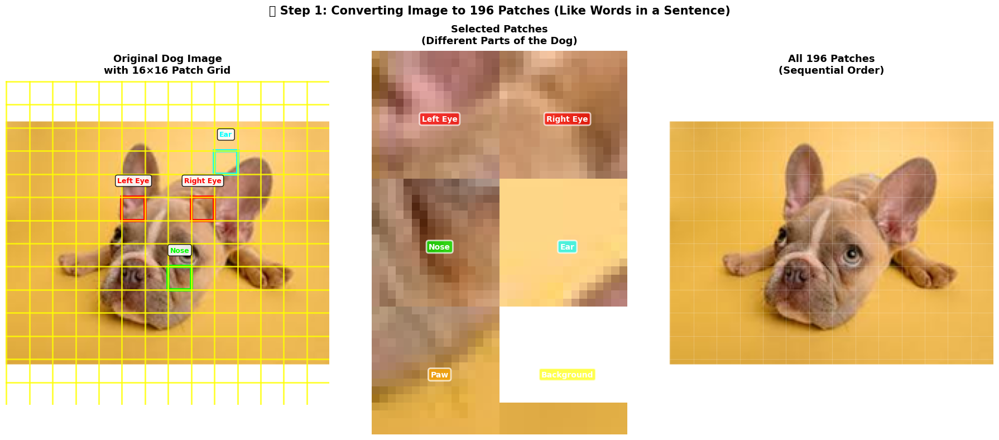


✅ Image successfully divided into 196 patches!
   Each patch is 16×16×3 = 768 pixel values
   These will become our 'visual words' for the transformer!

💡 Key Insight: Just like a sentence has words, our image now has 196 'visual words' (patches)!


In [ ]:
# STEP 1: Visualize Image Patching (FULLY CORRECTED VERSION)

def visualize_image_patches(image, patch_size=16):
    """Show how the dog image is split into patches"""
    h, w = image.shape[:2]
    num_patches_h = h // patch_size
    num_patches_w = w // patch_size

    print(f"🔍 Analyzing the image:")
    print(f"   Image size: {h}×{w} pixels")
    print(f"   Patch size: {patch_size}×{patch_size} pixels")
    print(f"   Grid: {num_patches_h}×{num_patches_w}")
    print(f"   Total patches: {num_patches_h * num_patches_w}")

    # Create visualization
    fig = plt.figure(figsize=(18, 8))

    # Left: Original image with grid overlay
    ax1 = plt.subplot(1, 3, 1)
    ax1.imshow(image)
    ax1.set_title('Original Dog Image\nwith 16×16 Patch Grid',
                 fontsize=13, fontweight='bold', pad=10)

    # Draw grid lines
    for i in range(0, h, patch_size):
        ax1.axhline(y=i, color='yellow', linewidth=2, alpha=0.8)
    for j in range(0, w, patch_size):
        ax1.axvline(x=j, color='yellow', linewidth=2, alpha=0.8)

    # Corrected coordinates for features
    # Left eye region
    left_eye_row, left_eye_col = 5, 5
    rect1 = plt.Rectangle((left_eye_col * patch_size, left_eye_row * patch_size),
                          patch_size, patch_size,
                          linewidth=4, edgecolor='red', facecolor='none')
    ax1.add_patch(rect1)
    ax1.text(left_eye_col * patch_size + patch_size//2,
            left_eye_row * patch_size - 10,
            'Left Eye', color='red', fontweight='bold',
            ha='center', fontsize=9,
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))

    # Right eye region
    right_eye_row, right_eye_col = 5, 8
    rect2 = plt.Rectangle((right_eye_col * patch_size, right_eye_row * patch_size),
                          patch_size, patch_size,
                          linewidth=4, edgecolor='red', facecolor='none')
    ax1.add_patch(rect2)
    ax1.text(right_eye_col * patch_size + patch_size//2,
            right_eye_row * patch_size - 10,
            'Right Eye', color='red', fontweight='bold',
            ha='center', fontsize=9,
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))

    # Nose region
    nose_row, nose_col = 8, 7
    rect3 = plt.Rectangle((nose_col * patch_size, nose_row * patch_size),
                          patch_size, patch_size,
                          linewidth=4, edgecolor='lime', facecolor='none')
    ax1.add_patch(rect3)
    ax1.text(nose_col * patch_size + patch_size//2,
            nose_row * patch_size - 10,
            'Nose', color='lime', fontweight='bold',
            ha='center', fontsize=9,
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))

    # Ear region
    ear_row, ear_col = 3, 9
    rect4 = plt.Rectangle((ear_col * patch_size, ear_row * patch_size),
                          patch_size, patch_size,
                          linewidth=4, edgecolor='cyan', facecolor='none')
    ax1.add_patch(rect4)
    ax1.text(ear_col * patch_size + patch_size//2,
            ear_row * patch_size - 10,
            'Ear', color='cyan', fontweight='bold',
            ha='center', fontsize=9,
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))

    ax1.axis('off')

    # Middle: Show selected patches
    ax2 = plt.subplot(1, 3, 2)

    # Extract the highlighted patches
    patches_to_show = [
        (5, 5, 'Left Eye', 'red'),
        (5, 8, 'Right Eye', 'red'),
        (8, 7, 'Nose', 'lime'),
        (3, 9, 'Ear', 'cyan'),
        (10, 7, 'Paw', 'orange'),
        (1, 1, 'Background', 'yellow')
    ]

    combined = np.ones((3 * patch_size, 2 * patch_size, 3), dtype=np.uint8) * 255

    for idx, (row, col, label, color) in enumerate(patches_to_show):
        if row < num_patches_h and col < num_patches_w:
            patch = image[row*patch_size:(row+1)*patch_size,
                         col*patch_size:(col+1)*patch_size]

            grid_row = idx // 2
            grid_col = idx % 2

            if grid_row < 3:
                combined[grid_row*patch_size:(grid_row+1)*patch_size,
                        grid_col*patch_size:(grid_col+1)*patch_size] = patch

    ax2.imshow(combined)
    ax2.set_title('Selected Patches\n(Different Parts of the Dog)',
                 fontsize=13, fontweight='bold', pad=10)
    ax2.axis('off')

    # Add labels with colors
    labels_grid = [
        [('Left Eye', 'red'), ('Right Eye', 'red')],
        [('Nose', 'lime'), ('Ear', 'cyan')],
        [('Paw', 'orange'), ('Background', 'yellow')]
    ]
    for i in range(3):
        for j in range(2):
            label, color = labels_grid[i][j]
            ax2.text(j*patch_size + patch_size//2, i*patch_size + patch_size//2,
                    label, color='white', fontweight='bold',
                    ha='center', va='center', fontsize=10,
                    bbox=dict(boxstyle='round', facecolor=color,
                             alpha=0.7, edgecolor='white', linewidth=2))

    # Right: Show all patches (CORRECTED - back to original working version)
    ax3 = plt.subplot(1, 3, 3)

    # Create a grid of all patches (14x14 = 196 patches)
    grid_h = num_patches_h
    grid_w = num_patches_w
    all_patches = np.ones((grid_h * patch_size, grid_w * patch_size, 3), dtype=np.uint8) * 255

    for i in range(grid_h):
        for j in range(grid_w):
            patch = image[i*patch_size:(i+1)*patch_size,
                         j*patch_size:(j+1)*patch_size]
            all_patches[i*patch_size:(i+1)*patch_size,
                       j*patch_size:(j+1)*patch_size] = patch

    ax3.imshow(all_patches)
    ax3.set_title(f'All {num_patches_h * num_patches_w} Patches\n(Sequential Order)',
                 fontsize=13, fontweight='bold', pad=10)
    ax3.axis('off')

    # Add grid lines to show patch boundaries
    for i in range(0, grid_h * patch_size, patch_size):
        ax3.axhline(y=i, color='white', linewidth=0.5, alpha=0.3)
    for j in range(0, grid_w * patch_size, patch_size):
        ax3.axvline(x=j, color='white', linewidth=0.5, alpha=0.3)

    plt.suptitle('🐕 Step 1: Converting Image to 196 Patches (Like Words in a Sentence)',
                fontsize=15, fontweight='bold', y=0.98)
    plt.tight_layout()
    plt.show()

    return num_patches_h * num_patches_w

print("="*70)
print("STEP 1: IMAGE PATCHING")
print("="*70)

# Visualize
num_patches = visualize_image_patches(test_image, patch_size=16)

print(f"\n✅ Image successfully divided into {num_patches} patches!")
print(f"   Each patch is 16×16×3 = 768 pixel values")
print(f"   These will become our 'visual words' for the transformer!")
print(f"\n💡 Key Insight: Just like a sentence has words, our image now has 196 'visual words' (patches)!")

---

## STEP 2: Convert Patches to Embeddings

**The Goal**: Transform each 16×16×3 patch into a 768-dimensional vector

### Breaking it Down

**Each patch has**:
- Size: 16 × 16 pixels
- Colors: 3 channels (RGB)
- Total values: 16 × 16 × 3 = **768 numbers**

**We convert these 768 numbers into a 768-dimensional embedding vector**

### How?
Use a **Convolutional Layer** as a clever trick:
```python
Conv2d(in_channels=3, out_channels=768, kernel_size=16, stride=16)
```

**Why this works**:
- `kernel_size=16`: Each filter looks at a 16×16 region
- `stride=16`: Filters don't overlap (jumps by 16)
- Result: Automatically extracts all patches AND embeds them!

### The Transformation
```
Input:  224×224×3 image
        ↓
Conv2d: Creates 768 feature maps of size 14×14
        ↓
Reshape: 14×14×768 → 196×768
        ↓
Output: 196 patch embeddings (each is 768-dimensional)
```

Each of the 196 patches is now a learnable 768-dimensional vector! 🎯

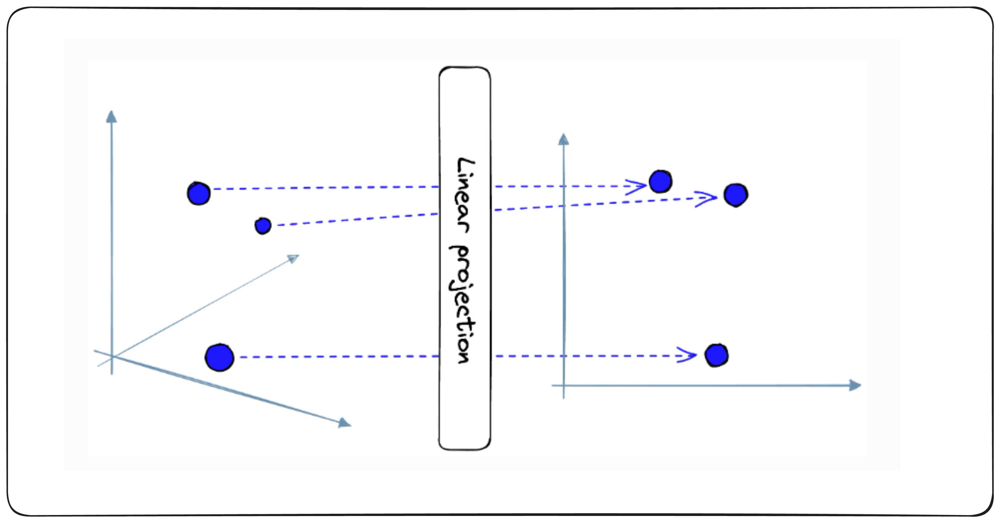

STEP 2: Patch Embedding

📷 Input: torch.Size([1, 3, 224, 224])
   → (batch=1, channels=3, height=224, width=224)

🎯 Output: torch.Size([1, 196, 768])
   → (batch=1, num_patches=196, embedding_dim=768)

✅ Success! Each of 196 patches is now a 768-dimensional vector


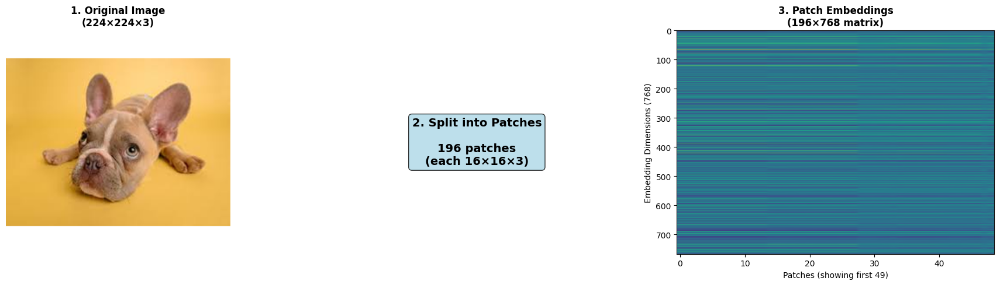

In [ ]:
# STEP 2: Patch Embedding Implementation

class PatchEmbedding(nn.Module):
    """
    Converts image into patch embeddings
    Simple version with clear steps
    """
    def __init__(self, image_size=224, patch_size=16, in_channels=3, embed_dim=768):
        super().__init__()

        self.image_size = image_size
        self.patch_size = patch_size
        self.num_patches = (image_size // patch_size) ** 2

        # The magic: Conv2d extracts and embeds patches in one step!
        self.projection = nn.Conv2d(
            in_channels=in_channels,
            out_channels=embed_dim,
            kernel_size=patch_size,
            stride=patch_size
        )

    def forward(self, x):
        # x shape: (batch, 3, 224, 224)

        # Apply convolution: extracts patches and projects to embed_dim
        x = self.projection(x)  # Shape: (batch, 768, 14, 14)

        # Flatten spatial dimensions
        x = x.flatten(2)  # Shape: (batch, 768, 196)

        # Transpose to get (batch, num_patches, embed_dim)
        x = x.transpose(1, 2)  # Shape: (batch, 196, 768)

        return x

# Test it
print("=" * 70)
print("STEP 2: Patch Embedding")
print("=" * 70)

patch_embed = PatchEmbedding(image_size=224, patch_size=16, embed_dim=768)

# Convert our test image to tensor
test_tensor = torch.FloatTensor(test_image).permute(2, 0, 1).unsqueeze(0) / 255.0
print(f"\n📷 Input: {test_tensor.shape}")
print(f"   → (batch=1, channels=3, height=224, width=224)")

# Get patch embeddings
patch_embeddings = patch_embed(test_tensor)
print(f"\n🎯 Output: {patch_embeddings.shape}")
print(f"   → (batch=1, num_patches=196, embedding_dim=768)")

print(f"\n✅ Success! Each of 196 patches is now a 768-dimensional vector")

# Visualize the transformation
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Original image
axes[0].imshow(test_image)
axes[0].set_title('1. Original Image\n(224×224×3)', fontsize=12, fontweight='bold')
axes[0].axis('off')

# Patches
axes[1].text(0.5, 0.5, f'2. Split into Patches\n\n196 patches\n(each 16×16×3)',
            ha='center', va='center', fontsize=14, fontweight='bold',
            transform=axes[1].transAxes,
            bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.8))
axes[1].axis('off')

# Embeddings visualization
embed_viz = patch_embeddings[0].detach().numpy()[:49]  # Show first 49
axes[2].imshow(embed_viz.T, cmap='viridis', aspect='auto')
axes[2].set_title('3. Patch Embeddings\n(196×768 matrix)', fontsize=12, fontweight='bold')
axes[2].set_xlabel('Patches (showing first 49)', fontsize=10)
axes[2].set_ylabel('Embedding Dimensions (768)', fontsize=10)

plt.tight_layout()
plt.show()

---

## STEP 3: Add CLS Token & Position Information

We need to add two special ingredients to make transformers work:

### 3A. CLS Token (Classification Token)

**What**: A special learnable vector (size 768)  
**Why**: Collects information from all patches for final classification  
**How**: Prepend it to the beginning of patch sequence

**Analogy**: Like adding a "summary" word at the start of a sentence that learns to capture the whole meaning.
```
Before: [Patch1, Patch2, ..., Patch196]  → 196 tokens
After:  [CLS, Patch1, Patch2, ..., Patch196] → 197 tokens
```

### 3B. Position Embeddings

**Problem**: Transformers don't know the order of patches!  
**Solution**: Add position information to each patch

**Think of it as**: Giving each patch a "seat number" so the model knows where it came from in the image.
```
Patch Embeddings (196×768)
         +
Position Info (196×768)
         ↓
Position-aware embeddings
```

### Complete Step 3
```
196 patch embeddings (196×768)
    ↓
Add CLS token → 197 tokens (197×768)
    ↓
Add position embeddings → Still 197×768 but now position-aware!
```

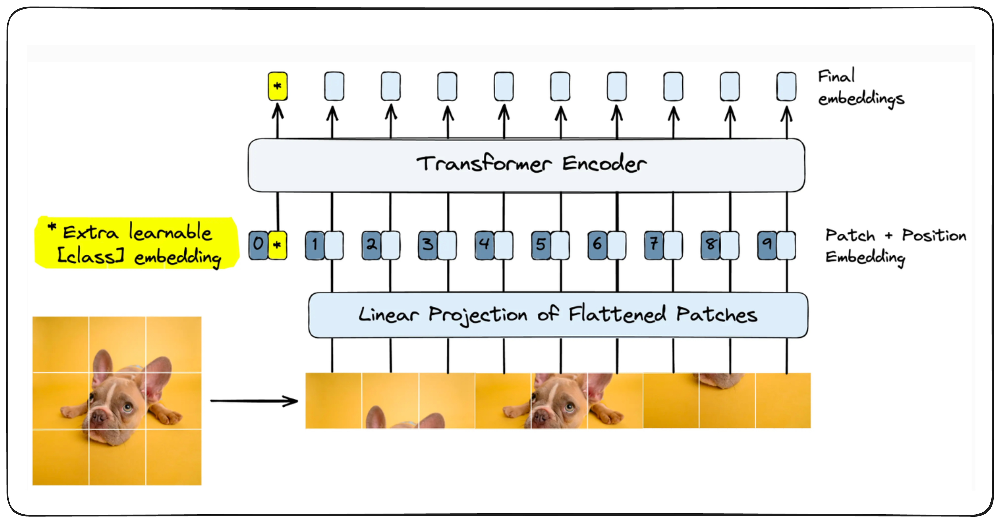

STEP 3: CLS Token + Position Embeddings

📊 Input: torch.Size([1, 3, 224, 224])
   → (batch, channels, height, width)

➕ After adding CLS token: 196 → 197 tokens
📍 After adding positions: Each token knows its location

🎯 Final Output: torch.Size([1, 197, 768])
   → (batch=1, tokens=197, embed_dim=768)

   Token 0: CLS (classification token)
   Tokens 1-196: Patch embeddings with position info


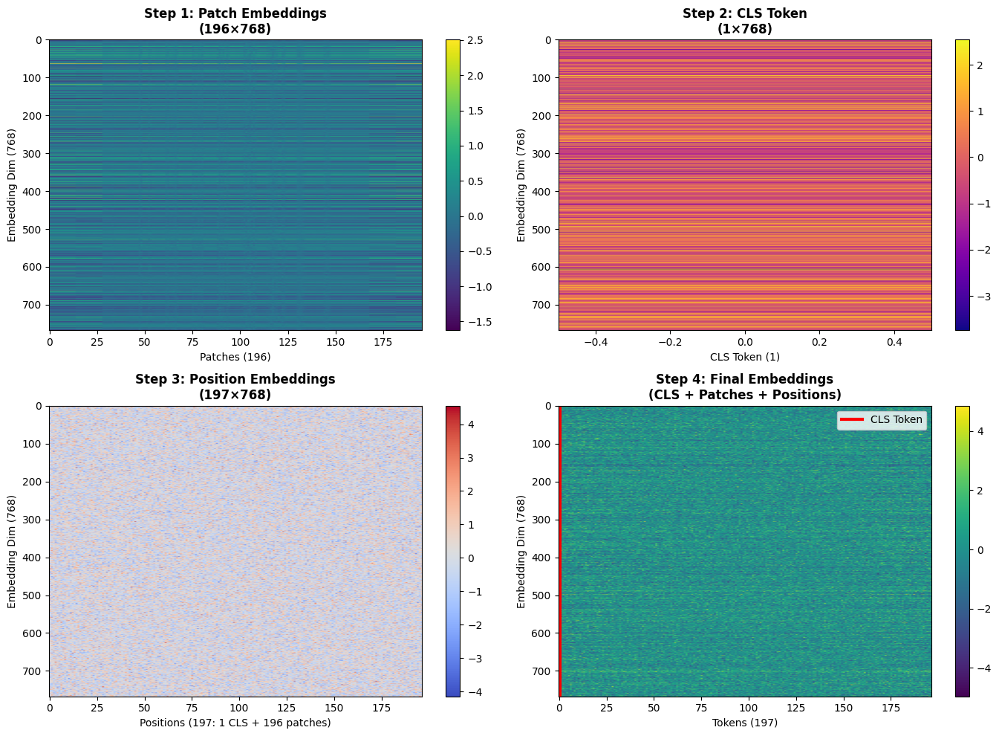


✅ Ready for Transformer! All tokens are now position-aware.


In [ ]:
# STEP 3: Add CLS Token and Position Embeddings

class ViTEmbeddings(nn.Module):
    """
    Complete embedding: Patches + CLS + Positions
    """
    def __init__(self, image_size=224, patch_size=16, in_channels=3, embed_dim=768):
        super().__init__()

        num_patches = (image_size // patch_size) ** 2

        # 1. Patch embedding layer
        self.patch_embedding = PatchEmbedding(image_size, patch_size, in_channels, embed_dim)

        # 2. CLS token - a learnable parameter
        self.cls_token = nn.Parameter(torch.randn(1, 1, embed_dim))

        # 3. Position embeddings - learnable for each position
        # +1 for CLS token
        self.position_embeddings = nn.Parameter(torch.randn(1, num_patches + 1, embed_dim))

    def forward(self, x):
        batch_size = x.shape[0]

        # Get patch embeddings
        x = self.patch_embedding(x)  # (batch, 196, 768)

        # Expand CLS token for batch
        cls_tokens = self.cls_token.expand(batch_size, -1, -1)  # (batch, 1, 768)

        # Prepend CLS token
        x = torch.cat([cls_tokens, x], dim=1)  # (batch, 197, 768)

        # Add position embeddings
        x = x + self.position_embeddings  # (batch, 197, 768)

        return x

# Test it
print("=" * 70)
print("STEP 3: CLS Token + Position Embeddings")
print("=" * 70)

vit_embeddings = ViTEmbeddings(image_size=224, patch_size=16, embed_dim=768)

# Process image
final_embeddings = vit_embeddings(test_tensor)

print(f"\n📊 Input: {test_tensor.shape}")
print(f"   → (batch, channels, height, width)")

print(f"\n➕ After adding CLS token: 196 → 197 tokens")
print(f"📍 After adding positions: Each token knows its location")

print(f"\n🎯 Final Output: {final_embeddings.shape}")
print(f"   → (batch=1, tokens=197, embed_dim=768)")
print(f"\n   Token 0: CLS (classification token)")
print(f"   Tokens 1-196: Patch embeddings with position info")

# Visualize the process
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Step 1: Patch embeddings
ax1 = axes[0, 0]
embed_viz = patch_embeddings[0].detach().numpy()
im1 = ax1.imshow(embed_viz.T, cmap='viridis', aspect='auto')
ax1.set_title('Step 1: Patch Embeddings\n(196×768)', fontsize=12, fontweight='bold')
ax1.set_xlabel('Patches (196)')
ax1.set_ylabel('Embedding Dim (768)')
plt.colorbar(im1, ax=ax1)

# Step 2: CLS token
ax2 = axes[0, 1]
cls_viz = vit_embeddings.cls_token[0].detach().numpy()
im2 = ax2.imshow(cls_viz.T, cmap='plasma', aspect='auto')
ax2.set_title('Step 2: CLS Token\n(1×768)', fontsize=12, fontweight='bold')
ax2.set_xlabel('CLS Token (1)')
ax2.set_ylabel('Embedding Dim (768)')
plt.colorbar(im2, ax=ax2)

# Step 3: Position embeddings
ax3 = axes[1, 0]
pos_viz = vit_embeddings.position_embeddings[0].detach().numpy()
im3 = ax3.imshow(pos_viz.T, cmap='coolwarm', aspect='auto')
ax3.set_title('Step 3: Position Embeddings\n(197×768)', fontsize=12, fontweight='bold')
ax3.set_xlabel('Positions (197: 1 CLS + 196 patches)')
ax3.set_ylabel('Embedding Dim (768)')
plt.colorbar(im3, ax=ax3)

# Step 4: Final combined
ax4 = axes[1, 1]
final_viz = final_embeddings[0].detach().numpy()
im4 = ax4.imshow(final_viz.T, cmap='viridis', aspect='auto')
ax4.set_title('Step 4: Final Embeddings\n(CLS + Patches + Positions)',
             fontsize=12, fontweight='bold')
ax4.set_xlabel('Tokens (197)')
ax4.set_ylabel('Embedding Dim (768)')
# Highlight CLS token
ax4.axvline(x=0.5, color='red', linewidth=3, label='CLS Token')
ax4.legend(loc='upper right')
plt.colorbar(im4, ax=ax4)

plt.tight_layout()
plt.show()

print("\n✅ Ready for Transformer! All tokens are now position-aware.")

---

## STEP 4: Transformer Encoder (The Brain)

**This is where the magic happens!** 🧠

### What It Does
Processes the 197 tokens through 12 layers of self-attention and feed-forward networks.

### Simple Analogy
Think of it like having a discussion group with 197 people (tokens):
- **Self-Attention**: Each person listens to everyone else
- **12 Layers**: The discussion happens 12 times, getting deeper each time
- **CLS Token**: The note-taker who summarizes everything

### One Transformer Layer
```
Input (197×768)
    ↓
Layer Norm
    ↓
Multi-Head Attention ─── (Each token talks to all tokens)
    ↓
Add & Residual Connection
    ↓
Layer Norm
    ↓
Feed Forward (MLP) ───── (Process each token)
    ↓
Add & Residual Connection
    ↓
Output (197×768)
```

**Repeat this 12 times!**

### Key Point
- Input shape: 197×768
- Output shape: 197×768 (same!)
- But the representations are now **much richer**

STEP 4: Transformer Encoder

📊 Input: torch.Size([1, 197, 768])
🎯 Output: torch.Size([1, 197, 768])

✅ Shape stays the same: (1, 197, 768)
   But representations are now richer!


/tmp/ipython-input-1056500019.py:112: UserWarning: Glyph 128260 (\N{ANTICLOCKWISE DOWNWARDS AND UPWARDS OPEN CIRCLE ARROWS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128260 (\N{ANTICLOCKWISE DOWNWARDS AND UPWARDS OPEN CIRCLE ARROWS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


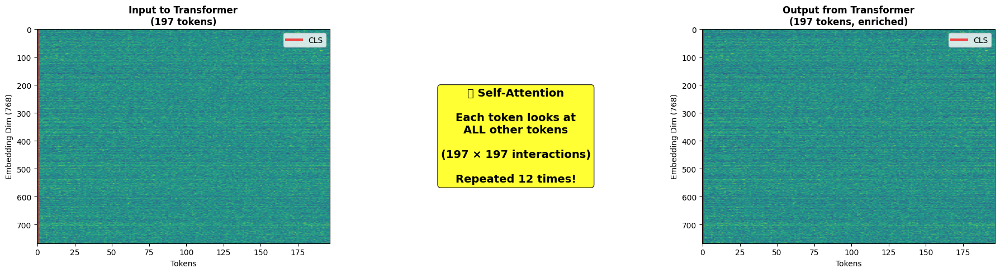


💡 After 12 such layers:
   • CLS token has 'seen' all patches
   • CLS token contains global image information
   • Ready for classification!


In [ ]:
# STEP 4: Transformer Encoder Block (Simplified)

class MultiHeadAttention(nn.Module):
    """Multi-head self-attention - simplified version"""
    def __init__(self, embed_dim=768, num_heads=12):
        super().__init__()
        self.num_heads = num_heads
        self.head_dim = embed_dim // num_heads

        # Query, Key, Value projections
        self.qkv = nn.Linear(embed_dim, embed_dim * 3)
        self.projection = nn.Linear(embed_dim, embed_dim)

    def forward(self, x):
        batch_size, num_tokens, embed_dim = x.shape

        # Generate Q, K, V
        qkv = self.qkv(x).reshape(batch_size, num_tokens, 3, self.num_heads, self.head_dim)
        qkv = qkv.permute(2, 0, 3, 1, 4)
        q, k, v = qkv[0], qkv[1], qkv[2]

        # Attention scores
        scores = torch.matmul(q, k.transpose(-2, -1)) / (self.head_dim ** 0.5)
        attn = torch.softmax(scores, dim=-1)

        # Apply attention to values
        out = torch.matmul(attn, v)
        out = out.transpose(1, 2).reshape(batch_size, num_tokens, embed_dim)
        out = self.projection(out)

        return out


class TransformerBlock(nn.Module):
    """One transformer encoder block"""
    def __init__(self, embed_dim=768, num_heads=12, mlp_ratio=4):
        super().__init__()

        # Layer normalization
        self.norm1 = nn.LayerNorm(embed_dim)
        self.norm2 = nn.LayerNorm(embed_dim)

        # Multi-head attention
        self.attention = MultiHeadAttention(embed_dim, num_heads)

        # MLP (Feed-forward)
        hidden_dim = int(embed_dim * mlp_ratio)
        self.mlp = nn.Sequential(
            nn.Linear(embed_dim, hidden_dim),
            nn.GELU(),
            nn.Linear(hidden_dim, embed_dim)
        )

    def forward(self, x):
        # Attention with residual
        x = x + self.attention(self.norm1(x))

        # MLP with residual
        x = x + self.mlp(self.norm2(x))

        return x


# Test transformer block
print("=" * 70)
print("STEP 4: Transformer Encoder")
print("=" * 70)

transformer_block = TransformerBlock(embed_dim=768, num_heads=12)

print(f"\n📊 Input: {final_embeddings.shape}")
output = transformer_block(final_embeddings)
print(f"🎯 Output: {output.shape}")
print(f"\n✅ Shape stays the same: (1, 197, 768)")
print(f"   But representations are now richer!")

# Visualize attention concept
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Input
ax1 = axes[0]
ax1.imshow(final_embeddings[0].detach().numpy().T, cmap='viridis', aspect='auto')
ax1.set_title('Input to Transformer\n(197 tokens)', fontsize=12, fontweight='bold')
ax1.set_xlabel('Tokens')
ax1.set_ylabel('Embedding Dim (768)')
ax1.axvline(x=0, color='red', linewidth=3, alpha=0.7, label='CLS')
ax1.legend()

# Attention concept
ax2 = axes[1]
ax2.text(0.5, 0.5,
         '🔄 Self-Attention\n\n' +
         'Each token looks at\nALL other tokens\n\n' +
         '(197 × 197 interactions)\n\n' +
         'Repeated 12 times!',
         ha='center', va='center',
         fontsize=14, fontweight='bold',
         transform=ax2.transAxes,
         bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.8))
ax2.axis('off')

# Output
ax3 = axes[2]
ax3.imshow(output[0].detach().numpy().T, cmap='viridis', aspect='auto')
ax3.set_title('Output from Transformer\n(197 tokens, enriched)',
             fontsize=12, fontweight='bold')
ax3.set_xlabel('Tokens')
ax3.set_ylabel('Embedding Dim (768)')
ax3.axvline(x=0, color='red', linewidth=3, alpha=0.7, label='CLS')
ax3.legend()

plt.tight_layout()
plt.show()

print("\n💡 After 12 such layers:")
print("   • CLS token has 'seen' all patches")
print("   • CLS token contains global image information")
print("   • Ready for classification!")

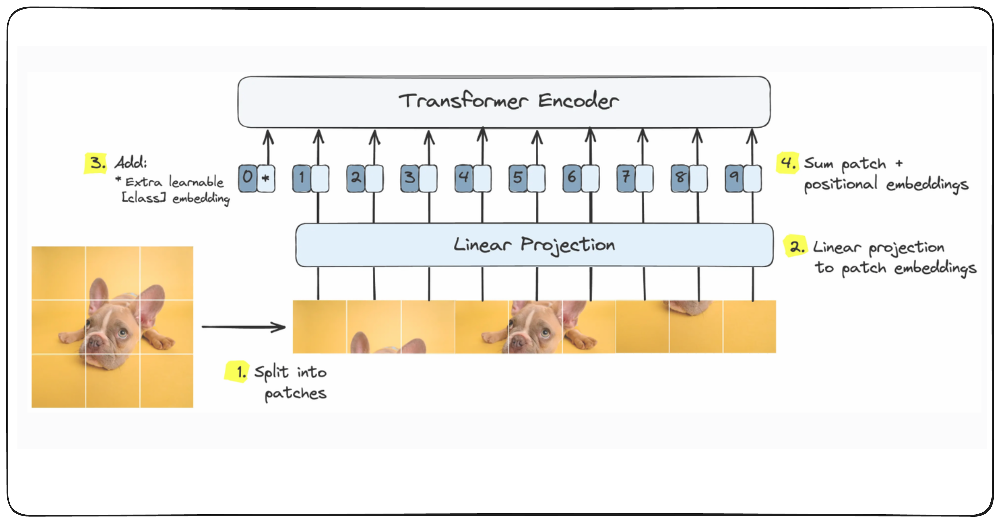

---

## STEP 5: Classification (The Final Answer)

**The simplest step!**

### What Happens
1. After 12 transformer layers, we have 197 tokens
2. **We only use the CLS token (token 0)**
3. Pass it through a simple linear layer
4. Get class predictions!

### Why Only CLS Token?
Through 12 layers of self-attention:
- CLS token has "talked to" all 196 patch tokens
- It has learned to summarize the entire image
- It's like the team captain who knows everything!

### The Math
```
Transformer Output: (batch, 197, 768)
    ↓
Extract CLS: (batch, 768)  ← Only take first token!
    ↓
Linear Layer: (batch, num_classes)
    ↓
Predictions!
```

### Complete ViT Pipeline
```
Image (224×224×3)
    ↓ Patch
196 patches
    ↓ Embed
196×768 embeddings
    ↓ Add CLS + Position
197×768 embeddings
    ↓ 12× Transformer
197×768 (enriched)
    ↓ Extract CLS
1×768
    ↓ Classify
num_classes predictions
```

COMPLETE VISION TRANSFORMER

📷 Input Image: torch.Size([1, 3, 224, 224])
🎯 Predictions: torch.Size([1, 10])
   → (batch=1, num_classes=10)

📊 Total Parameters: 85,806,346


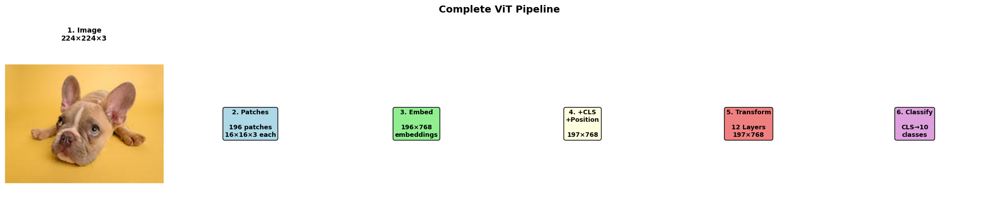


✅ Vision Transformer Complete!

Key Takeaways:
  • Image → Patches → Embeddings
  • CLS token collects global information
  • 12 transformer layers process everything
  • CLS token used for final classification


In [ ]:
# STEP 5: Complete Vision Transformer

class VisionTransformer(nn.Module):
    """Complete ViT - All steps together!"""
    def __init__(
        self,
        image_size=224,
        patch_size=16,
        in_channels=3,
        num_classes=10,
        embed_dim=768,
        depth=12,
        num_heads=12,
        mlp_ratio=4
    ):
        super().__init__()

        # Step 1-3: Embeddings (Patches + CLS + Position)
        self.embeddings = ViTEmbeddings(image_size, patch_size, in_channels, embed_dim)

        # Step 4: Transformer Encoder (12 layers)
        self.encoder = nn.Sequential(*[
            TransformerBlock(embed_dim, num_heads, mlp_ratio)
            for _ in range(depth)
        ])

        # Step 5: Classification Head
        self.norm = nn.LayerNorm(embed_dim)
        self.classifier = nn.Linear(embed_dim, num_classes)

    def forward(self, x):
        # Steps 1-3: Get embeddings
        x = self.embeddings(x)  # (batch, 197, 768)

        # Step 4: Transform
        x = self.encoder(x)  # (batch, 197, 768)

        # Step 5: Classify using CLS token
        x = self.norm(x)
        cls_token = x[:, 0]  # Extract CLS token (batch, 768)
        logits = self.classifier(cls_token)  # (batch, num_classes)

        return logits


# Create complete model
print("=" * 70)
print("COMPLETE VISION TRANSFORMER")
print("=" * 70)

vit_model = VisionTransformer(
    image_size=224,
    patch_size=16,
    num_classes=10,  # e.g., CIFAR-10
    embed_dim=768,
    depth=12,
    num_heads=12
)

# Test end-to-end
print(f"\n📷 Input Image: {test_tensor.shape}")
predictions = vit_model(test_tensor)
print(f"🎯 Predictions: {predictions.shape}")
print(f"   → (batch=1, num_classes=10)")

# Count parameters
total_params = sum(p.numel() for p in vit_model.parameters())
print(f"\n📊 Total Parameters: {total_params:,}")

# Visualize complete pipeline
fig, axes = plt.subplots(1, 6, figsize=(20, 4))

# Step 1
axes[0].imshow(test_image)
axes[0].set_title('1. Image\n224×224×3', fontsize=10, fontweight='bold')
axes[0].axis('off')

# Step 2
axes[1].text(0.5, 0.5, '2. Patches\n\n196 patches\n16×16×3 each',
            ha='center', va='center', fontsize=9, fontweight='bold',
            transform=axes[1].transAxes,
            bbox=dict(boxstyle='round', facecolor='lightblue'))
axes[1].axis('off')

# Step 3
axes[2].text(0.5, 0.5, '3. Embed\n\n196×768\nembeddings',
            ha='center', va='center', fontsize=9, fontweight='bold',
            transform=axes[2].transAxes,
            bbox=dict(boxstyle='round', facecolor='lightgreen'))
axes[2].axis('off')

# Step 4
axes[3].text(0.5, 0.5, '4. +CLS\n+Position\n\n197×768',
            ha='center', va='center', fontsize=9, fontweight='bold',
            transform=axes[3].transAxes,
            bbox=dict(boxstyle='round', facecolor='lightyellow'))
axes[3].axis('off')

# Step 5
axes[4].text(0.5, 0.5, '5. Transform\n\n12 Layers\n197×768',
            ha='center', va='center', fontsize=9, fontweight='bold',
            transform=axes[4].transAxes,
            bbox=dict(boxstyle='round', facecolor='lightcoral'))
axes[4].axis('off')

# Step 6
axes[5].text(0.5, 0.5, '6. Classify\n\nCLS→10\nclasses',
            ha='center', va='center', fontsize=9, fontweight='bold',
            transform=axes[5].transAxes,
            bbox=dict(boxstyle='round', facecolor='plum'))
axes[5].axis('off')

plt.suptitle('Complete ViT Pipeline', fontsize=14, fontweight='bold', y=1.05)
plt.tight_layout()
plt.show()

print("\n" + "=" * 70)
print("✅ Vision Transformer Complete!")
print("=" * 70)
print("\nKey Takeaways:")
print("  • Image → Patches → Embeddings")
print("  • CLS token collects global information")
print("  • 12 transformer layers process everything")
print("  • CLS token used for final classification")
print("=" * 70)

---

## Summary: What We Built

### The 5 Steps (Visual Summary)

| Step | Input | Output | What Happens |
|------|-------|--------|--------------|
| **1. Patchify** | 224×224×3 image | 196 patches | Split image like words |
| **2. Embed** | 196 patches | 196×768 vectors | Convert to embeddings |
| **3. Add Tokens** | 196×768 | 197×768 | Add CLS + positions |
| **4. Transform** | 197×768 | 197×768 | 12 layers of attention |
| **5. Classify** | 197×768 | num_classes | Use CLS token |

### Key Numbers to Remember

- **Patch size**: 16×16 pixels
- **Number of patches**: 196 (for 224×224 image)
- **Embedding dimension**: 768
- **Total tokens**: 197 (1 CLS + 196 patches)
- **Transformer layers**: 12
- **Attention heads**: 12

### Why It Works

1. **Global Attention**: Every patch sees every other patch from layer 1
2. **CLS Token**: Learns to summarize the whole image
3. **Deep Processing**: 12 layers refine understanding
4. **Scalable**: Works better with more data

---

## Next Steps

Now that you understand ViT:
- ✅ Train it on real data (CIFAR-10)
- ✅ Use pretrained models (ImageNet)
- ✅ Visualize attention maps
- ✅ Compare with CNNs

**Ready to train? Let's go!** 🚀

#TBD: Train a Llama/ViT using Huggingface
This we will see in the Finetuning Classes(Upcoming)

# Multimodality - An Introduction

## What is Multimodality?

**Multimodal AI** refers to systems that can understand and process multiple types of data (modalities) simultaneously - such as text, images, audio, and video.


# Example:
# CLIP: Connecting Vision and Language 🔗

## What is CLIP?

**CLIP (Contrastive Language-Image Pre-training)** is a groundbreaking model from OpenAI (2021) that bridges vision and language by learning visual concepts from natural language descriptions.

### The Big Idea

Instead of training on labeled images (cat, dog, car), CLIP learns from **400 million (image, text) pairs** scraped from the internet.


**Traditional Vision Model**:

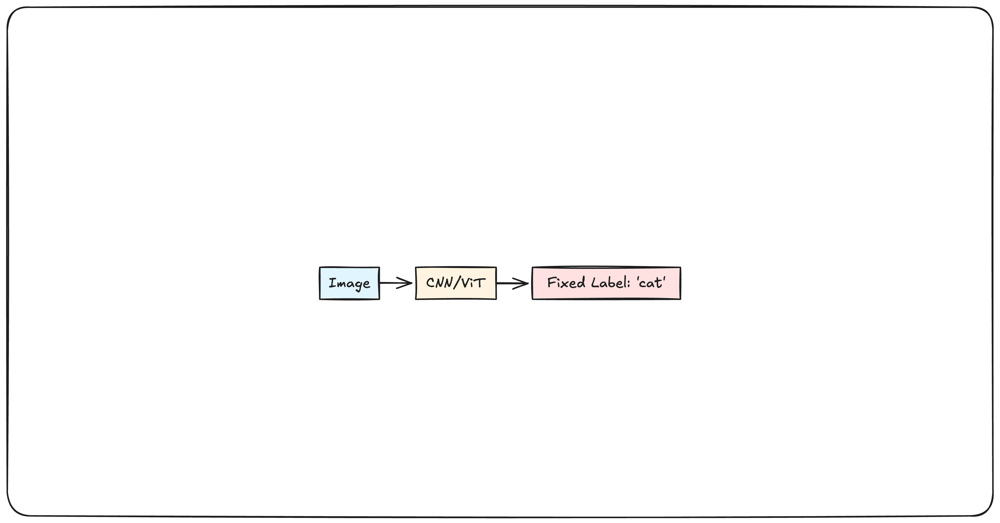

## **CLIP Architecture**:

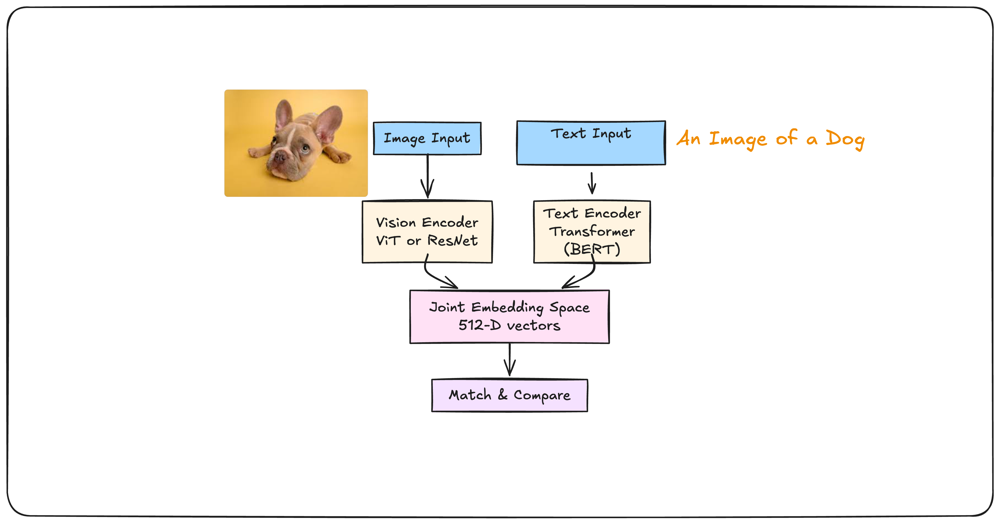

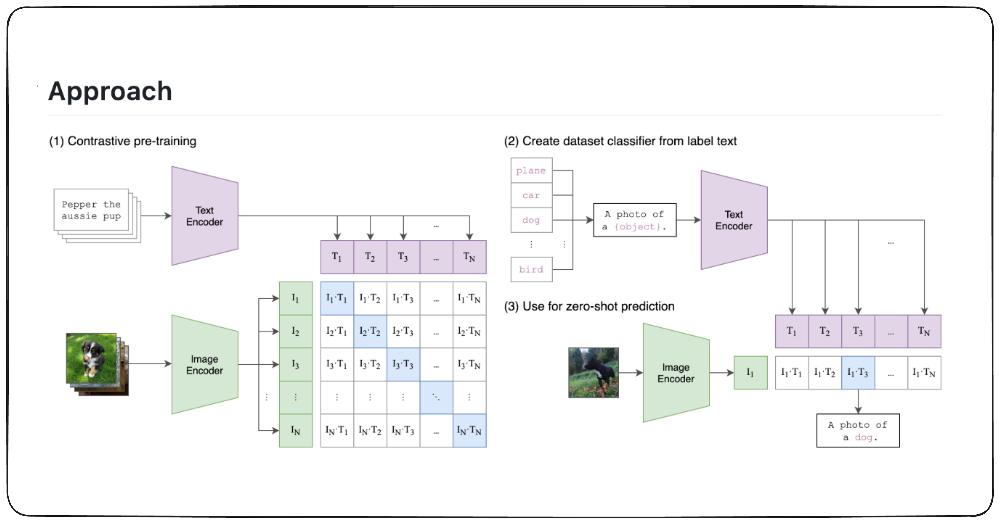

**From Training Siamese Nets to ....**

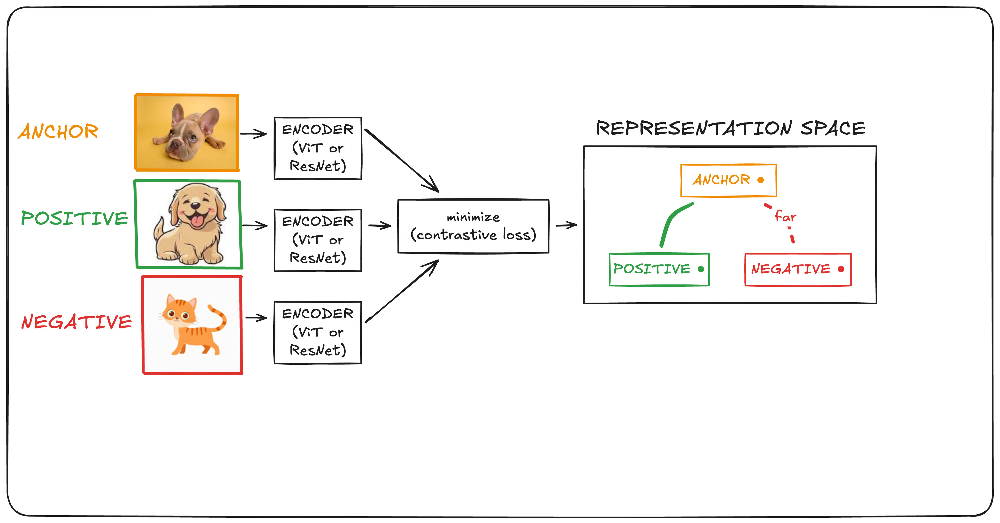

**Training CLIP**

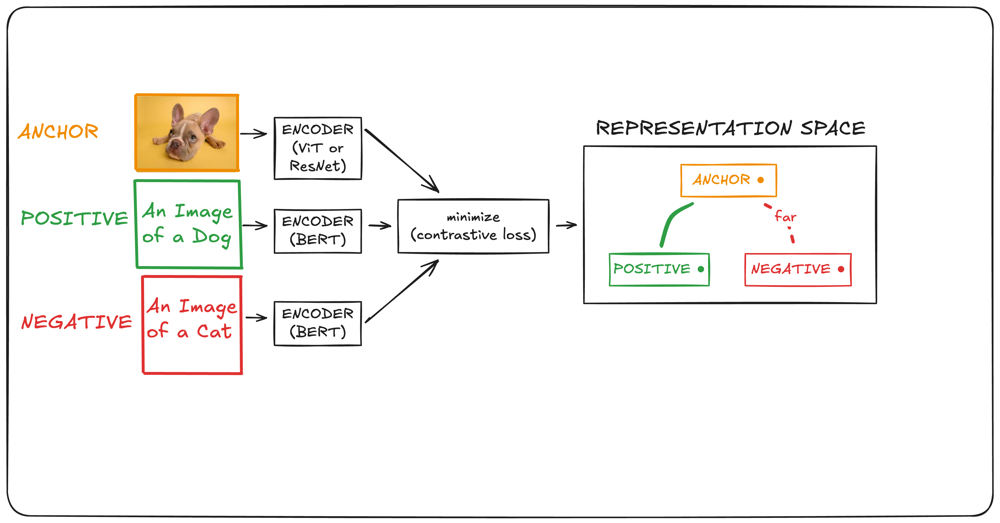

**Contrastive Loss**

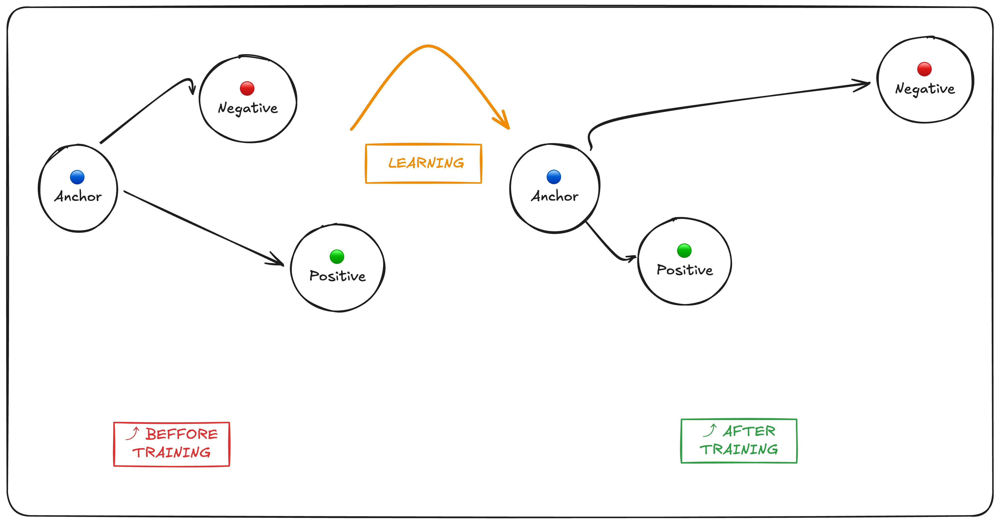

In [ ]:
# Install CLIP
!pip install git+https://github.com/openai/CLIP.git -q
!pip install ftfy regex tqdm -q

print("✅ CLIP installed successfully!")

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 1.5 MB/s eta 0:00:00
✅ CLIP installed successfully!


In [ ]:
# CLIP Demo with Our French Bulldog Image

import torch
import clip
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

print("="*70)
print("CLIP DEMO: Zero-Shot Classification")
print("="*70)

# Load CLIP model
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"\n📱 Using device: {device}")
print("🔄 Loading CLIP model...")

model, preprocess = clip.load("ViT-B/32", device=device)
print("✅ CLIP ViT-B/32 loaded successfully!")

# Load our French Bulldog image
image_path = '/content/dog_image.jpeg'
image = Image.open(image_path)

# Preprocess image for CLIP
image_input = preprocess(image).unsqueeze(0).to(device)

print(f"\n🖼️ Image loaded and preprocessed")
print(f"   Original size: {image.size}")
print(f"   Processed shape: {image_input.shape}")

CLIP DEMO: Zero-Shot Classification

📱 Using device: cpu
🔄 Loading CLIP model...


100%|███████████████████████████████████████| 338M/338M [00:08<00:00, 44.2MiB/s]


✅ CLIP ViT-B/32 loaded successfully!

🖼️ Image loaded and preprocessed
   Original size: (259, 194)
   Processed shape: torch.Size([1, 3, 224, 224])



TEST 1: Dog Breed Classification

🏆 CLIP Predictions (Top to Bottom):

1. a photo of a French Bulldog              93.55%
2. a photo of a Chihuahua                    5.92%
3. a photo of a Pug                          0.27%
4. a photo of a Labrador                     0.18%
5. a photo of a Golden Retriever             0.03%
6. a photo of a German Shepherd              0.03%
7. a photo of a cat                          0.01%
8. a photo of a bird                         0.00%


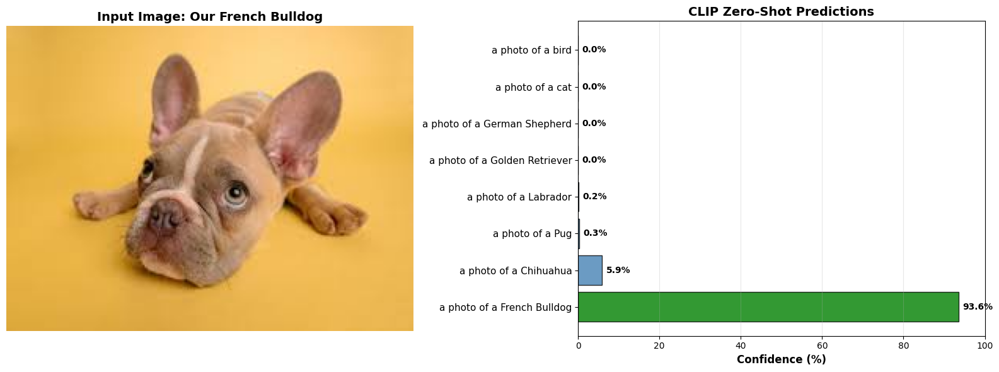


✅ CLIP correctly identified: a photo of a French Bulldog


In [ ]:
# Test 1: Basic Dog Breed Classification

print("\n" + "="*70)
print("TEST 1: Dog Breed Classification")
print("="*70)

# Define text descriptions
text_descriptions = [
    "a photo of a French Bulldog",
    "a photo of a Golden Retriever",
    "a photo of a German Shepherd",
    "a photo of a Pug",
    "a photo of a Chihuahua",
    "a photo of a Labrador",
    "a photo of a cat",
    "a photo of a bird"
]

# Tokenize text
text_tokens = clip.tokenize(text_descriptions).to(device)

# Get predictions
with torch.no_grad():
    # Encode image and text
    image_features = model.encode_image(image_input)
    text_features = model.encode_text(text_tokens)

    # Normalize features
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)

    # Compute similarity (cosine similarity * 100)
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(8)

# Display results
print("\n🏆 CLIP Predictions (Top to Bottom):\n")
for i, (value, index) in enumerate(zip(values, indices), 1):
    print(f"{i}. {text_descriptions[index]:40s} {value.item()*100:5.2f}%")

# Visualize
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Show image
axes[0].imshow(image)
axes[0].set_title('Input Image: Our French Bulldog', fontsize=14, fontweight='bold')
axes[0].axis('off')

# Show prediction bars
colors = ['green' if i == 0 else 'steelblue' for i in range(len(values))]
y_pos = np.arange(len(values))
axes[1].barh(y_pos, values.cpu().numpy() * 100, color=colors, alpha=0.8, edgecolor='black')
axes[1].set_yticks(y_pos)
axes[1].set_yticklabels([text_descriptions[idx] for idx in indices], fontsize=11)
axes[1].set_xlabel('Confidence (%)', fontsize=12, fontweight='bold')
axes[1].set_title('CLIP Zero-Shot Predictions', fontsize=14, fontweight='bold')
axes[1].grid(axis='x', alpha=0.3)
axes[1].set_xlim(0, 100)

# Add percentage labels
for i, v in enumerate(values.cpu().numpy() * 100):
    axes[1].text(v + 1, i, f'{v:.1f}%', va='center', fontweight='bold')

plt.tight_layout()
plt.show()

print(f"\n✅ CLIP correctly identified: {text_descriptions[indices[0]]}")